In [ ]:
import numpy as np


In [ ]:
import os
import zipfile
import glob
import cv2
from sklearn.model_selection import train_test_split
from numpy import mean
from numpy import std
from matplotlib import pyplot
from sklearn.model_selection import KFold
from keras.utils import to_categorical
from keras.models import Sequential
from keras.layers import Conv2D, Dropout, BatchNormalization, AveragePooling2D
from keras.layers import MaxPooling2D
from keras.layers import Dense,UpSampling2D, LeakyReLU
from keras.layers import Flatten
from keras.optimizers import SGD
import random
from tensorflow.keras import activations
from keras.layers import Activation
from keras.optimizers import Adam
from keras.models import Input, Model
from tqdm import tqdm
import matplotlib.pyplot as plt


In [ ]:
ls

sample_data/


In [ ]:
!unzip '/content/digits.zip'

Streaming output truncated to the last 5000 lines.
  inflating: digits/116/0_KIS_19_3_209.jpg  
  inflating: digits/116/0_KIS_20_3_210.jpg  
  inflating: digits/116/0_KIS_22_3_212.jpg  
  inflating: digits/116/0_KIS_22_3_213.jpg  
  inflating: digits/116/0_KUL_13_1_1168.jpg  
  inflating: digits/116/0_KURI_20_3_1169.jpg  
  inflating: digits/116/0_KURI_22_3_214.jpg  
  inflating: digits/116/0_KURI_23_3_215.jpg  
  inflating: digits/116/0_KURI_23_3_216.jpg  
  inflating: digits/116/0_KUSH_16_2_1170.jpg  
  inflating: digits/116/0_KUSH_17_2_1171.jpg  
  inflating: digits/116/0_KUSH_19_3_217.jpg  
  inflating: digits/116/0_KUSH_20_3_218.jpg  
  inflating: digits/116/0_KUSH_20_3_219.jpg  
  inflating: digits/116/0_KUSH_21_3_1172.jpg  
  inflating: digits/116/0_KUSH_22_3_221.jpg  
  inflating: digits/116/0_KUSH_23_3_222.jpg  
  inflating: digits/116/0_KUS_11_1_1173.jpg  
  inflating: digits/116/0_KUS_12_1_1174.jpg  
  inflating: digits/116/0_KUS_13_1_1175.jpg  
  inflating: digits/116/0_KUS

In [ ]:
import glob

li = glob.glob('digits/*')

In [ ]:
j = 0
Y = []
img_list = []

In [ ]:


for i in li:
  for k in glob.glob(i+'/*'):
    img = cv2.imread(k, cv2.IMREAD_GRAYSCALE)
    image = ~img
    image = cv2.resize(image, (28,28))
    img_list.append(image)
    Y.append(j)
    print(k+" inserted and the value is "+ str(j))
  j+=1

  


Streaming output truncated to the last 5000 lines.
digits/118/0_BOG_18_3_467.jpg inserted and the value is 8
digits/118/1_DHA_13_1_186.jpg inserted and the value is 8
digits/118/0_DHA_16_1_946.jpg inserted and the value is 8
digits/118/1_RAJ_11_1_1445.jpg inserted and the value is 8
digits/118/0_SHIR_21_3_316.jpg inserted and the value is 8
digits/118/1_DHA_13_1_192.jpg inserted and the value is 8
digits/118/1_DHA_13_1_912.jpg inserted and the value is 8
digits/118/0_PAB_15_1_1367.jpg inserted and the value is 8
digits/118/1_DHA_12_1_783.jpg inserted and the value is 8
digits/118/1_BHOLA_12_1_471.jpg inserted and the value is 8
digits/118/0_BOR_12_6_470.jpg inserted and the value is 8
digits/118/0_JES_18_3_1132.jpg inserted and the value is 8
digits/118/0_FENI_22_3_169.jpg inserted and the value is 8
digits/118/0_DHA_17_2_981.jpg inserted and the value is 8
digits/118/0_NAO_24_3_255.jpg inserted and the value is 8
digits/118/1_COM_11_1_576.jpg inserted and the value is 8
digits/118/1_R

In [ ]:
import pandas as pd

df = pd.DataFrame()
df['X'] = img_list
df['Y'] = Y

In [ ]:
df.to_csv("Dataset_ekushe.csv")

In [ ]:
X = np.array(img_list)

In [ ]:
y = np.array(Y)


In [ ]:
y.shape

(30688,)

Reshaping dataset 

In [ ]:
# reshape dataset to have a single channel
#X = X.reshape((X.shape[0], 32, 32, 1))


In [ ]:
#normalizing data
#X = X / 255.0


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

In [ ]:
y_train.shape
y_tr = np.copy(y_train)
y_te = np.copy(y_test) 

In [ ]:
#loading mnist

#(X_train, y_train), (X_test, y_test )= mnist.load_data()

In [ ]:
# Converting integer values to float types 
X_train = X_train.astype(np.float32)
X_test = X_test.astype(np.float32)
# Scaling and centering
X_train = (X_train - 127.5) / 127.5
X_test = (X_test - 127.5)/ 127.5
 print('Maximum pixel value in the training_set after Centering and Scaling: ', np.max(X_train))
print('Minimum pixel value in the training_set after Centering and Scaling: ', np.min(X_train))

Maximum pixel value in the training_set after Centering and Scaling:  1.0
Minimum pixel value in the training_set after Centering and Scaling:  -1.0


In [ ]:
# Rescale the pixel values (0 and 255)
def upscale(image):
    return (image*127.5 + 127.5).astype(np.uint8)
# Lets see if this works
z = upscale(X_train[0])
print('Maximum pixel value after upscaling scaled image: ',np.max(z))
print('Maximum pixel value after upscaling scaled image: ',np.min(z))

Maximum pixel value after upscaling scaled image:  255
Maximum pixel value after upscaling scaled image:  0


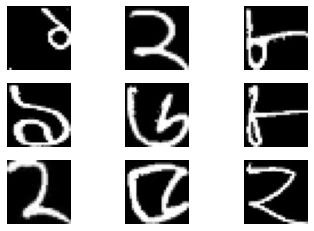

In [ ]:
for i in range(0, 9):
    plt.subplot(331+i) # plot of 3 rows and 3 columns
    plt.axis('off') # turn off axis
    plt.imshow(upscale(X_train[i]), cmap='gray') # gray scale

In [ ]:
def define_model(input_shape, X_train, y_train):
  model = Sequential()
  model.add(Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_uniform', input_shape=(28, 28, 1)))
  model.add(MaxPooling2D((2, 2)))
  model.add(Flatten())
  model.add(Dense(100, activation='relu', kernel_initializer='he_uniform'))
  model.add(Dense(10, activation='softmax'))
	# compile model
  opt = SGD(lr=0.01, momentum=0.9)
  model.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])
  history = model.fit(X_train, y_train, batch_size = 128, epochs = 10, validation_split=0.2)
  return model, history
	

Noising part ( Add noise )

In [ ]:
def noising(image):
    array = np.array(image)
    i = random.choice(range(8,12)) # x coordinate for the top left corner of the mask
    j = random.choice(range(8,12)) # y coordinate for the top left corner of the mask
    array[5:i+10, 5:i+10]=-1 # setting the pixels in the masked region to -1
    return array

In [ ]:
noised_train_data = np.array([*map(noising, X_train)])
noised_test_data = np.array([*map(noising, X_test)])
print('Noised train data Shape/Dimension : ', noised_train_data.shape)
print('Noised test data Shape/Dimension : ', noised_train_data.shape)

Noised train data Shape/Dimension :  (24550, 28, 28)
Noised test data Shape/Dimension :  (24550, 28, 28)


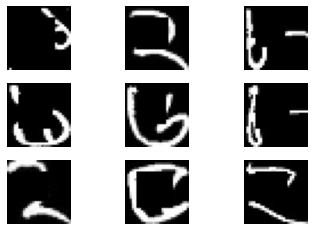

In [ ]:
# Plot of 9 scaled noised images after upscaling
for i in range(0, 9):
    plt.subplot(331+i) # plot of 3 rows and 3 columns
    plt.axis('off') # turn off axis
    plt.imshow(upscale(noised_train_data[i]), cmap='gray') # gray scale

Reshapping Data

In [ ]:
# Reshaping the training data
X_train = X_train.reshape(X_train.shape[0], X_train.shape[1], X_train.shape[2], 1)
print('Size/Shape of the original training set: ', X_train.shape)
# Reshaping the noised training data
noised_train_data = noised_train_data.reshape(noised_train_data.shape[0],
noised_train_data.shape[1],
noised_train_data.shape[2], 1)
print('Size/Shape of the noised training set: ', noised_train_data.shape)

# Reshaping the testing data
X_test = X_test.reshape(X_test.shape[0], X_test.shape[1], X_test.shape[2], 1)
print('Size/Shape of the original test set: ', X_test.shape)

# Reshaping the noised testing data
noised_test_data = noised_test_data.reshape(noised_test_data.shape[0],
noised_test_data.shape[1],
noised_test_data.shape[2], 1)
print('Size/Shape of the noised test set: ', noised_test_data.shape)

Size/Shape of the original training set:  (24550, 28, 28, 1)
Size/Shape of the noised training set:  (24550, 28, 28, 1)
Size/Shape of the original test set:  (6138, 28, 28, 1)
Size/Shape of the noised test set:  (6138, 28, 28, 1)


In [ ]:
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

In [ ]:
# input image shape
input_shape = (28,28,1)

In [ ]:
def train_mnist(input_shape, X_train, y_train):
  model = Sequential()
  model.add(Conv2D(32, (3, 3), strides=2, padding='same',
  input_shape=input_shape))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Conv2D(64, (3, 3), strides=2, padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))

  model.add(Conv2D(128, (3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(0.2))
  model.add(Flatten())

  model.add(Dense(1024, activation = 'relu'))
  model.add(Dense(10, activation='softmax'))
  model.compile(loss = 'categorical_crossentropy',
  optimizer = 'adam', metrics = ['accuracy'])
  history = model.fit(X_train, y_train, batch_size = 128, epochs = 10, validation_split=0.2)
  return model, history


In [ ]:
mnist_model, history = train_mnist(input_shape, X_train, y_train)

Epoch 1/10
154/154 [==============================] - 2s 11ms/step - loss: 0.9472 - accuracy: 0.7095 - val_loss: 0.2547 - val_accuracy: 0.9210
Epoch 2/10
154/154 [==============================] - 2s 10ms/step - loss: 0.2403 - accuracy: 0.9201 - val_loss: 0.1795 - val_accuracy: 0.9444
Epoch 3/10
154/154 [==============================] - 2s 11ms/step - loss: 0.1384 - accuracy: 0.9548 - val_loss: 0.1442 - val_accuracy: 0.9536
Epoch 4/10
154/154 [==============================] - 2s 11ms/step - loss: 0.0865 - accuracy: 0.9719 - val_loss: 0.1239 - val_accuracy: 0.9601
Epoch 5/10
154/154 [==============================] - 2s 11ms/step - loss: 0.0634 - accuracy: 0.9790 - val_loss: 0.1239 - val_accuracy: 0.9599
Epoch 6/10
154/154 [==============================] - 2s 10ms/step - loss: 0.0522 - accuracy: 0.9832 - val_loss: 0.1154 - val_accuracy: 0.9621
Epoch 7/10
154/154 [==============================] - 2s 10ms/step - loss: 0.0286 - accuracy: 0.9903 - val_loss: 0.1254 - val_accuracy: 0.9678

In [ ]:
mnits_model2, history2 = define_model(input_shape, X_train, y_train)

Epoch 1/10
154/154 [==============================] - 2s 9ms/step - loss: 2.7694 - accuracy: 0.4824 - val_loss: 0.5058 - val_accuracy: 0.8334
Epoch 2/10
154/154 [==============================] - 1s 7ms/step - loss: 0.4566 - accuracy: 0.8470 - val_loss: 0.4182 - val_accuracy: 0.8589
Epoch 3/10
154/154 [==============================] - 1s 7ms/step - loss: 0.3324 - accuracy: 0.8856 - val_loss: 0.3652 - val_accuracy: 0.8784
Epoch 4/10
154/154 [==============================] - 1s 7ms/step - loss: 0.3079 - accuracy: 0.8982 - val_loss: 0.3413 - val_accuracy: 0.8923
Epoch 5/10
154/154 [==============================] - 1s 7ms/step - loss: 0.2618 - accuracy: 0.9118 - val_loss: 0.3166 - val_accuracy: 0.8980
Epoch 6/10
154/154 [==============================] - 1s 7ms/step - loss: 0.2243 - accuracy: 0.9242 - val_loss: 0.3164 - val_accuracy: 0.8992
Epoch 7/10
154/154 [==============================] - 1s 7ms/step - loss: 0.1933 - accuracy: 0.9337 - val_loss: 0.3029 - val_accuracy: 0.9039
Epoch 

In [ ]:
# prediction on the masked images
mnits_model2.evaluate(noised_test_data,y_test)

192/192 [==============================] - 0s 2ms/step - loss: 0.7120 - accuracy: 0.7828


[0.7119917273521423, 0.7828282713890076]

In [ ]:
mnist_model.evaluate(X_test,y_test)

192/192 [==============================] - 0s 2ms/step - loss: 0.1261 - accuracy: 0.9692


[0.12610578536987305, 0.9692082405090332]

Defining hyperparameters for GAN
The following are some of the hyperparameters defined that we will be using throughout the code and are totally configurable:

In [ ]:
# Smoothing value
smooth_real = 0.9
# Number of epochs
epochs = 5

# Batchsize
batch_size = 128

# Optimizer for the generator
optimizer_g = Adam(lr=0.0002, beta_1=0.5)

# Optimizer for the discriminator
optimizer_d = Adam(lr=0.0004, beta_1=0.5)

# Shape of the input image
input_shape = (28,28,1)

In [ ]:
def generated_images_plot(original, noised_data, generator):
  print('NOISED')
  for i in range(9):
    plt.subplot(331 + i)
    plt.axis('off')
    plt.imshow(upscale(np.squeeze(noised_data[i])), cmap='gray') # upscale for plotting
    plt.show()

  print('GENERATED')
  for i in range(9):
    pred = generator.predict(noised_data[i:i+1], verbose=0)
    plt.subplot(331 + i)
    plt.axis('off')
    plt.imshow(upscale(np.squeeze(pred[0])), cmap='gray') # upscale to avoid plotting errors
    plt.show()

  print('ORIGINAL')
  for i in range(9):
    plt.subplot(331 + i)
    plt.axis('off')
    plt.imshow(upscale(np.squeeze(original[i])), cmap='gray') # upscale for plotting
    plt.show()

In [ ]:
def plot_training_loss(discriminator_losses, generator_losses):
    """Plot the losses."""
    plt.figure()
    plt.plot(range(len(discriminator_losses)), discriminator_losses,
             color='red', label='Discriminator loss')
    plt.plot(range(len(generator_losses)), generator_losses,
             color='blue', label='Adversarial loss')
    plt.title('Discriminator and Adversarial loss')
    plt.xlabel('Iterations')
    plt.ylabel('Loss (Adversarial/Discriminator)')
    plt.legend()
    plt.show()

In [ ]:
def plot_generated_images_combined(original, noised_data, generator):
  rows, cols = 4, 12
  num = rows * cols
  image_size = 28
  generated_images = generator.predict(noised_data[0:num])

  imgs = np.concatenate([original[0:num], noised_data[0:num], generated_images])
  imgs = imgs.reshape((rows * 3, cols, image_size, image_size))
  imgs = np.vstack(np.split(imgs, rows, axis=1))
  imgs = imgs.reshape((rows * 3, -1, image_size, image_size))
  imgs = np.vstack([np.hstack(i) for i in imgs])
  imgs = upscale(imgs)
  plt.figure(figsize=(8,16))
  plt.axis('off')
  plt.title('Original Images: top rows, '
  'Corrupted Input: middle rows, '
  'Generated Images: bottom rows')
  plt.imshow(imgs, cmap='gray')
  plt.show()

In [ ]:
def img_generator(input_shape):
    """Generator."""
    generator = Sequential()
    generator.add(Conv2D(32, (3, 3), padding='same', input_shape=input_shape))
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    generator.add(AveragePooling2D(pool_size=(2, 2)))
    generator.add(Conv2D(64, (3, 3), padding='same'))
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    generator.add(AveragePooling2D(pool_size=(2, 2)))
    generator.add(Conv2D(128, (3, 3), padding='same'))
    generator.add(BatchNormalization())
    generator.add(Activation('relu'))
    generator.add(Conv2D(128, (3, 3), padding='same'))
    generator.add(Activation('relu'))
    generator.add(UpSampling2D((2, 2)))
    generator.add(Conv2D(64, (3, 3), padding='same'))
    generator.add(Activation('relu'))
    generator.add(UpSampling2D((2, 2)))
    generator.add(Conv2D(1, (3, 3), activation='tanh', padding='same'))
    return generator


def img_discriminator(input_shape):
    """Discriminator."""
    discriminator = Sequential()
    discriminator.add(Conv2D(32, (3, 3), strides=2, padding='same',
                      input_shape=input_shape))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    discriminator.add(Conv2D(128, (3, 3), strides=2, padding='same'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    discriminator.add(Conv2D(256, (3, 3), padding='same'))
    discriminator.add(LeakyReLU(0.2))
    discriminator.add(Dropout(0.2))
    discriminator.add(Flatten())
    discriminator.add(Dense(1, activation='sigmoid'))
    return discriminator


def dcgan(discriminator, generator, input_shape):
    """DCGAN."""
    discriminator.trainable = False
    # Accepts the noised input
    gan_input = Input(shape=input_shape)
    # Generates image by passing the above received input to the generator
    gen_img = generator(gan_input)
    # Feeds the generated image to the discriminator
    gan_output = discriminator(gen_img)
    # Compile everything as a model with binary crossentropy loss
    gan = Model(inputs=gan_input, outputs=gan_output)
    return gan

  0%|          | 0/191 [00:00<?, ?it/s]

Epoch 1
Iteration - %d 1
NOISED


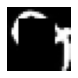

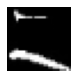

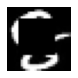

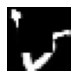

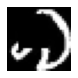

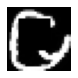

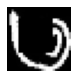

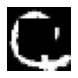

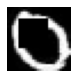

GENERATED


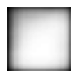

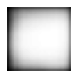

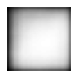

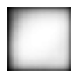

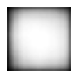

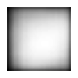

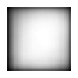

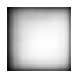

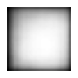

ORIGINAL


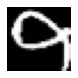

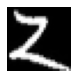

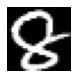

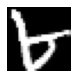

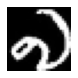

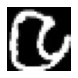

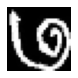

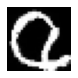

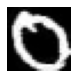

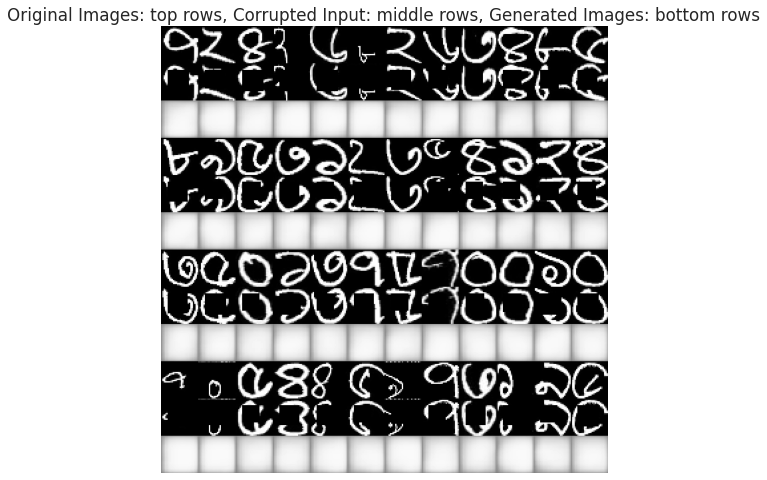

100%|██████████| 191/191 [00:17<00:00, 10.87it/s]


Discriminator Loss:  0.6123461127281189 , Adversarial Loss:  0.2601502537727356
NOISED


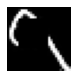

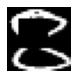

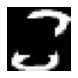

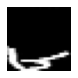

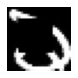

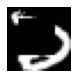

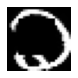

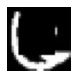

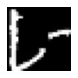

GENERATED


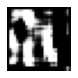

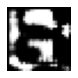

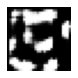

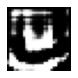

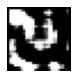

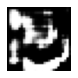

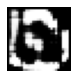

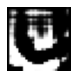

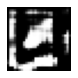

ORIGINAL


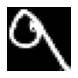

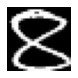

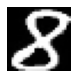

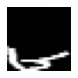

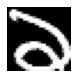

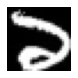

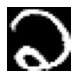

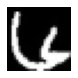

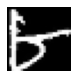

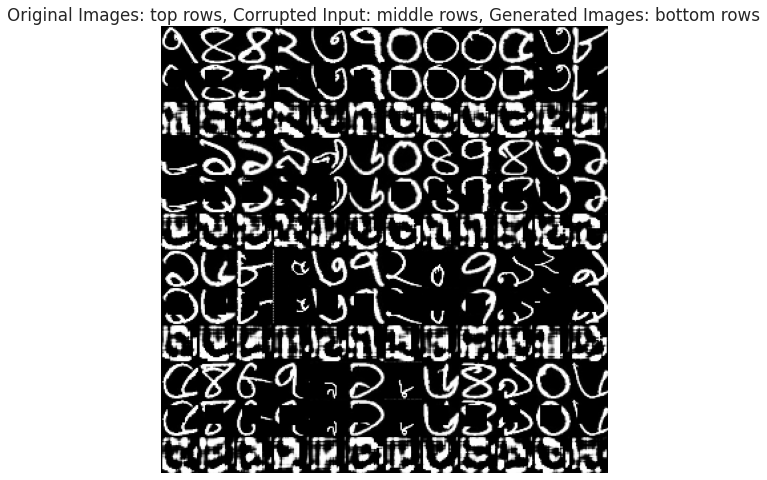

  1%|          | 2/191 [00:00<00:15, 11.93it/s]

Epoch 2


100%|██████████| 191/191 [00:12<00:00, 14.79it/s]


Discriminator Loss:  0.6039161682128906 , Adversarial Loss:  1.3551158905029297
NOISED


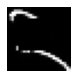

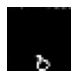

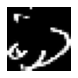

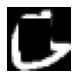

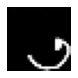

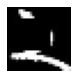

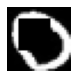

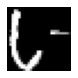

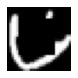

GENERATED


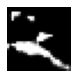

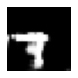

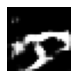

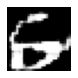

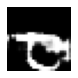

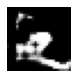

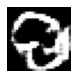

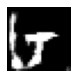

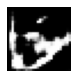

ORIGINAL


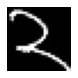

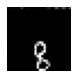

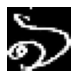

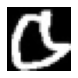

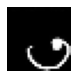

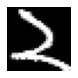

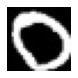

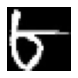

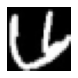

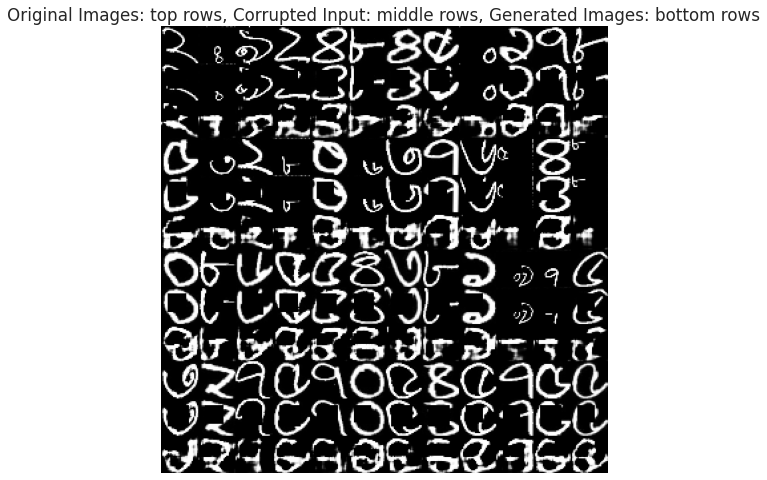

  1%|          | 2/191 [00:00<00:16, 11.70it/s]

Epoch 3


100%|██████████| 191/191 [00:12<00:00, 15.18it/s]

Discriminator Loss:  0.6135491132736206 , Adversarial Loss:  1.1030439138412476
NOISED


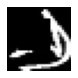

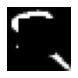

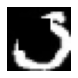

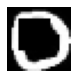

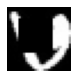

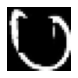

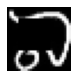

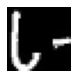

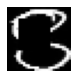

GENERATED


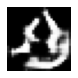

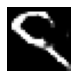

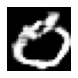

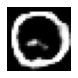

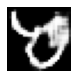

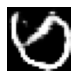

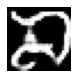

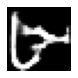

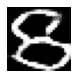

ORIGINAL


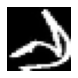

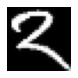

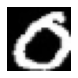

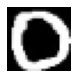

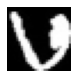

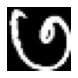

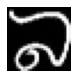

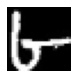

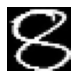

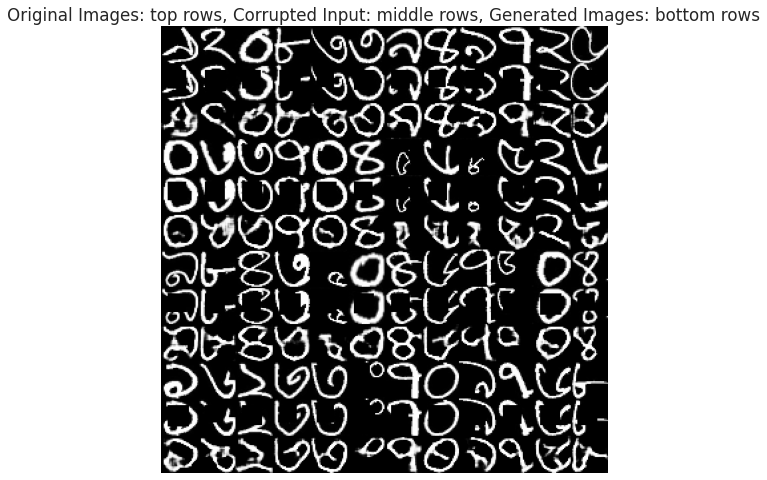

  1%|          | 2/191 [00:00<00:16, 11.52it/s]

Epoch 4


100%|██████████| 191/191 [00:12<00:00, 15.29it/s]

Discriminator Loss:  0.621457040309906 , Adversarial Loss:  0.9163563847541809
NOISED


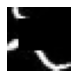

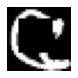

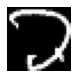

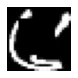

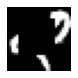

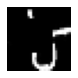

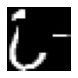

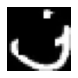

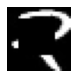

GENERATED


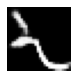

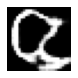

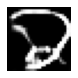

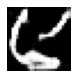

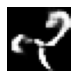

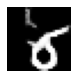

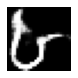

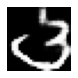

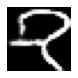

ORIGINAL


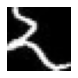

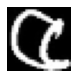

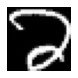

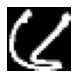

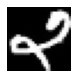

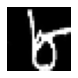

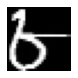

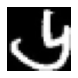

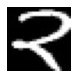

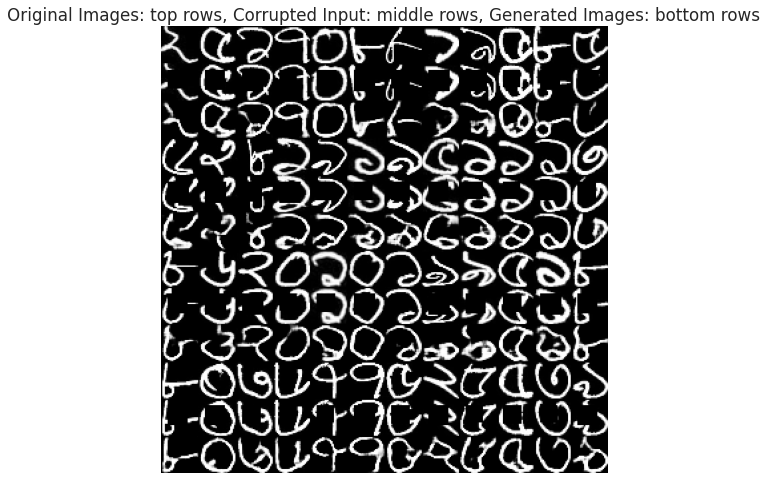

  1%|          | 2/191 [00:00<00:16, 11.46it/s]

Epoch 5


100%|██████████| 191/191 [00:12<00:00, 15.25it/s]


Discriminator Loss:  0.6529957056045532 , Adversarial Loss:  0.946045994758606
NOISED


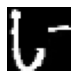

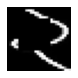

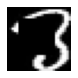

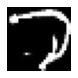

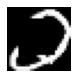

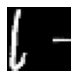

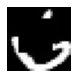

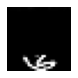

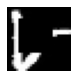

GENERATED


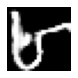

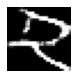

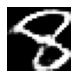

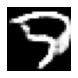

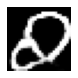

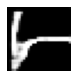

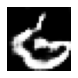

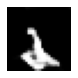

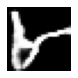

ORIGINAL


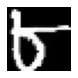

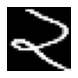

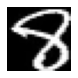

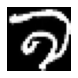

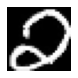

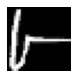

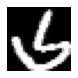

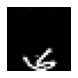

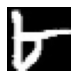

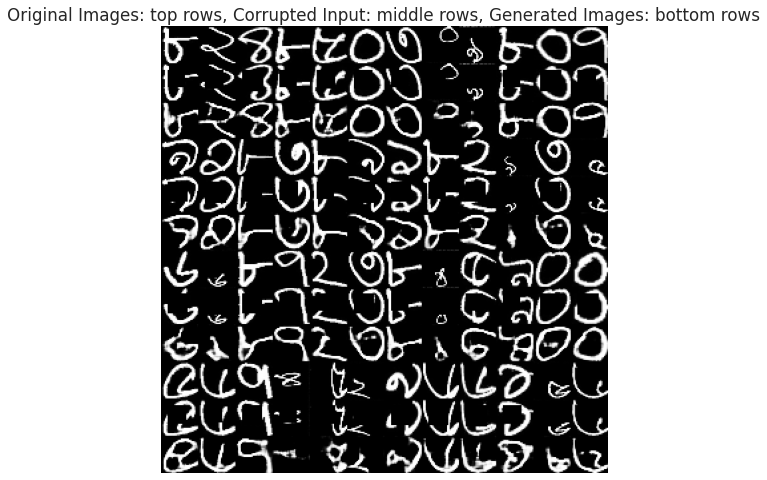

  1%|          | 2/191 [00:00<00:15, 12.22it/s]

Epoch 6


100%|██████████| 191/191 [00:12<00:00, 14.97it/s]


Discriminator Loss:  0.6294713020324707 , Adversarial Loss:  1.0017865896224976
NOISED


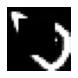

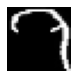

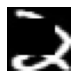

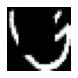

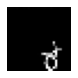

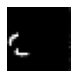

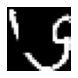

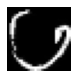

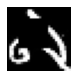

GENERATED


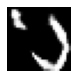

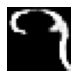

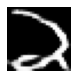

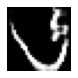

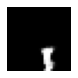

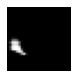

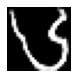

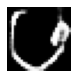

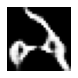

ORIGINAL


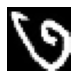

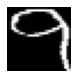

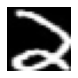

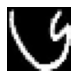

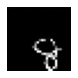

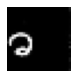

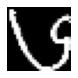

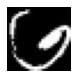

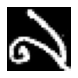

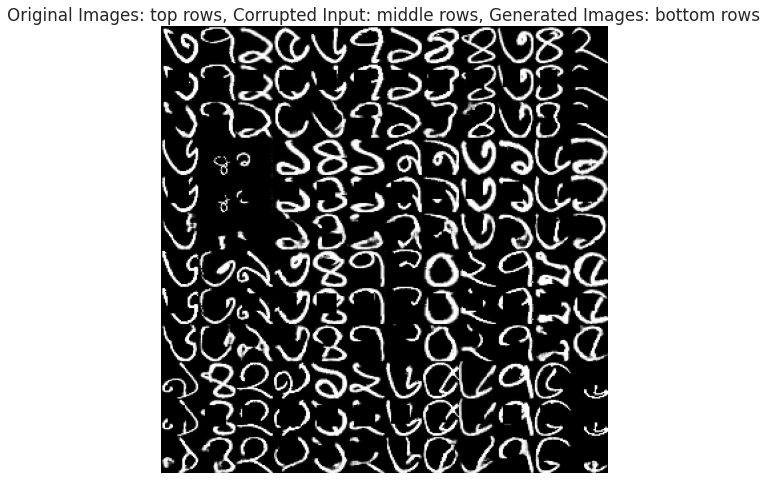

  1%|          | 2/191 [00:00<00:15, 12.42it/s]

Epoch 7


100%|██████████| 191/191 [00:12<00:00, 14.88it/s]

Discriminator Loss:  0.5765775442123413 , Adversarial Loss:  1.0049247741699219
NOISED


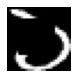

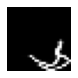

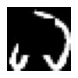

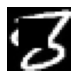

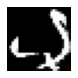

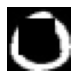

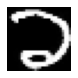

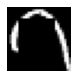

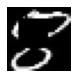

GENERATED


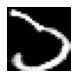

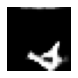

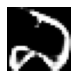

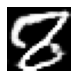

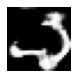

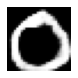

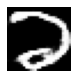

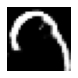

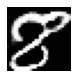

ORIGINAL


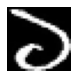

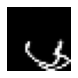

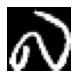

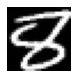

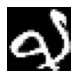

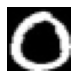

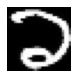

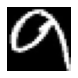

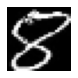

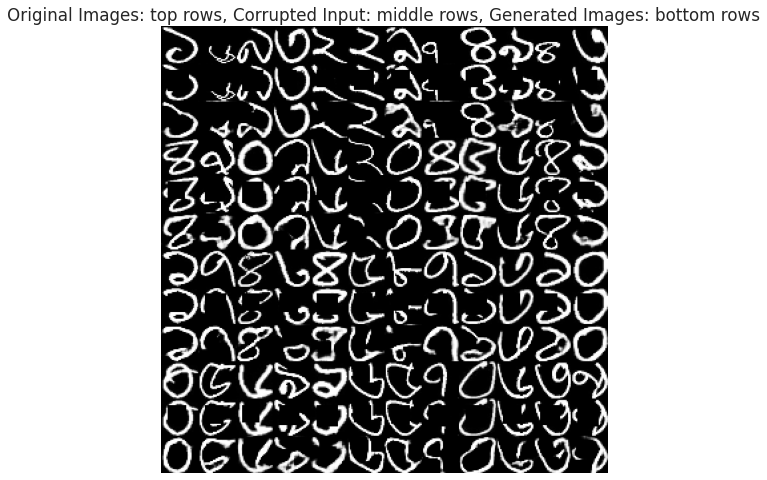

  1%|          | 2/191 [00:00<00:16, 11.63it/s]

Epoch 8


100%|██████████| 191/191 [00:12<00:00, 15.56it/s]


Discriminator Loss:  0.5996481776237488 , Adversarial Loss:  1.0208985805511475
NOISED


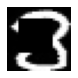

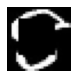

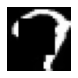

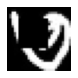

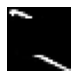

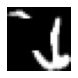

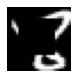

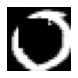

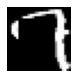

GENERATED


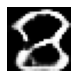

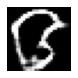

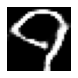

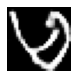

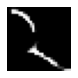

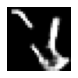

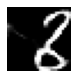

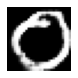

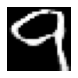

ORIGINAL


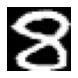

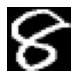

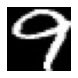

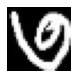

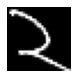

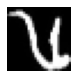

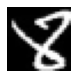

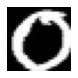

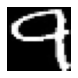

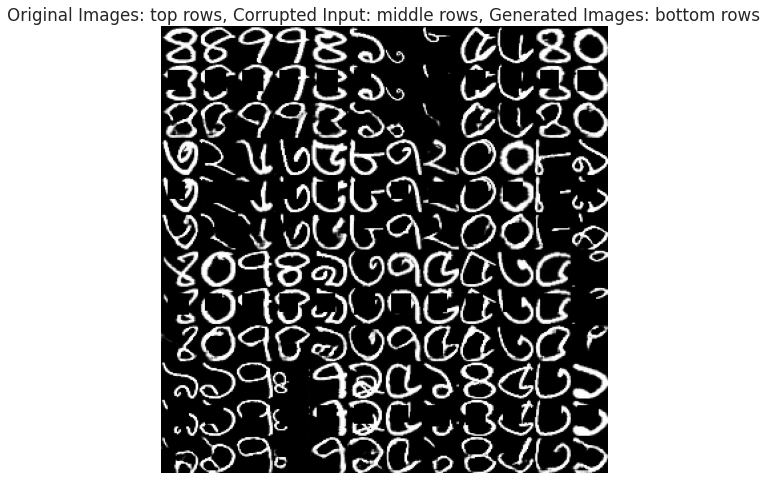

  0%|          | 0/191 [00:00<?, ?it/s]

Epoch 9


100%|██████████| 191/191 [00:12<00:00, 15.05it/s]


Discriminator Loss:  0.6853938698768616 , Adversarial Loss:  0.9165427684783936
NOISED


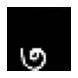

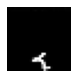

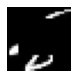

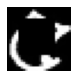

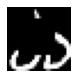

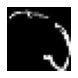

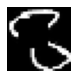

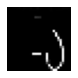

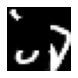

GENERATED


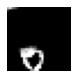

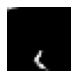

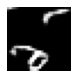

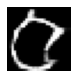

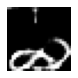

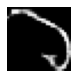

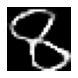

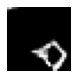

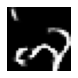

ORIGINAL


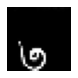

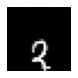

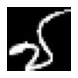

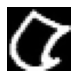

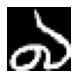

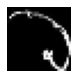

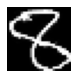

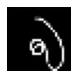

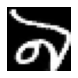

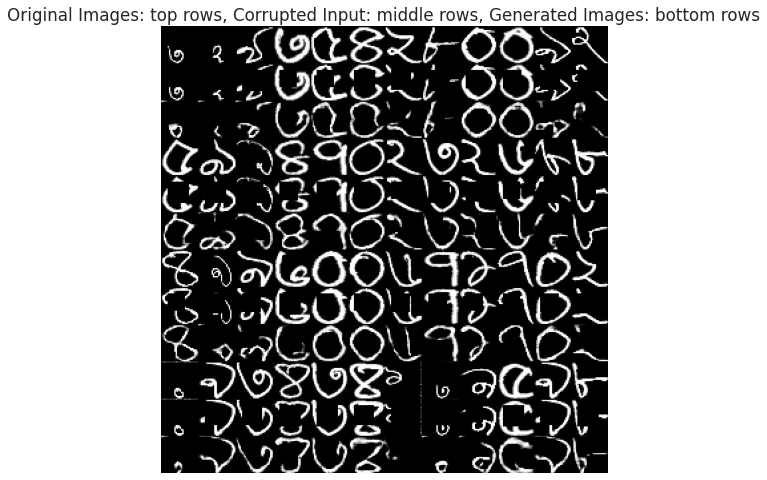

  1%|          | 2/191 [00:00<00:16, 11.81it/s]

Epoch 10


100%|██████████| 191/191 [00:12<00:00, 15.39it/s]


Discriminator Loss:  0.6105451583862305 , Adversarial Loss:  1.0514605045318604
NOISED


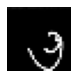

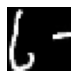

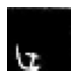

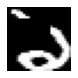

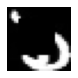

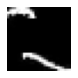

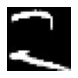

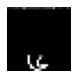

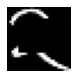

GENERATED


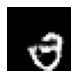

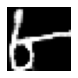

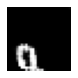

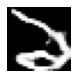

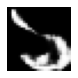

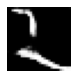

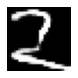

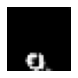

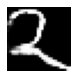

ORIGINAL


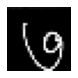

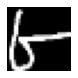

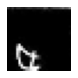

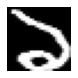

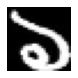

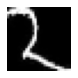

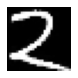

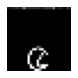

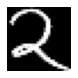

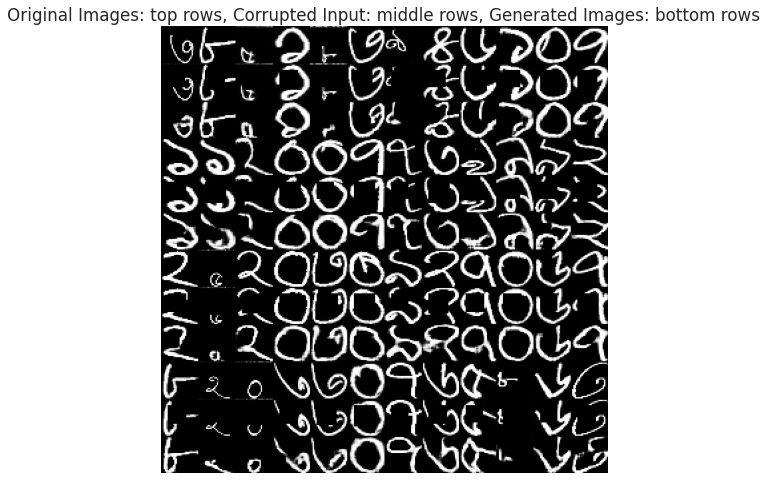

  1%|          | 1/191 [00:00<00:19,  9.88it/s]

Epoch 11


100%|██████████| 191/191 [00:12<00:00, 15.00it/s]


Discriminator Loss:  0.6184895634651184 , Adversarial Loss:  1.1904972791671753
NOISED


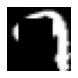

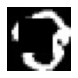

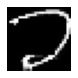

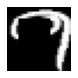

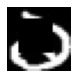

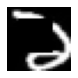

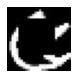

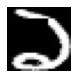

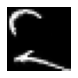

GENERATED


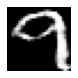

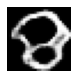

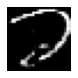

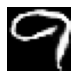

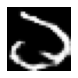

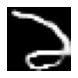

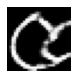

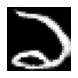

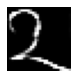

ORIGINAL


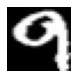

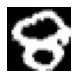

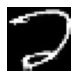

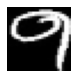

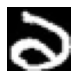

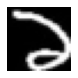

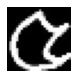

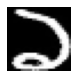

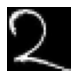

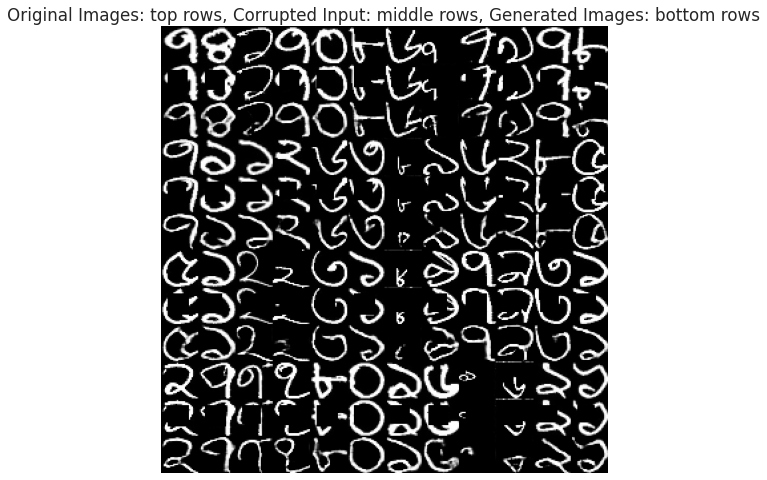

  1%|          | 2/191 [00:00<00:14, 12.65it/s]

Epoch 12


100%|██████████| 191/191 [00:12<00:00, 14.84it/s]

Discriminator Loss:  0.6242125630378723 , Adversarial Loss:  0.9758785963058472
NOISED


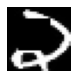

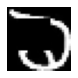

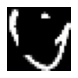

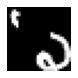

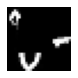

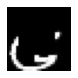

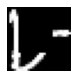

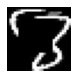

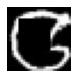

GENERATED


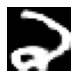

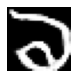

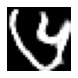

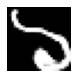

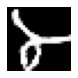

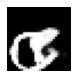

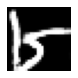

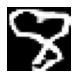

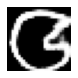

ORIGINAL


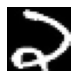

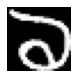

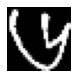

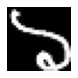

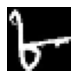

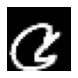

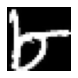

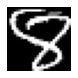

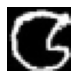

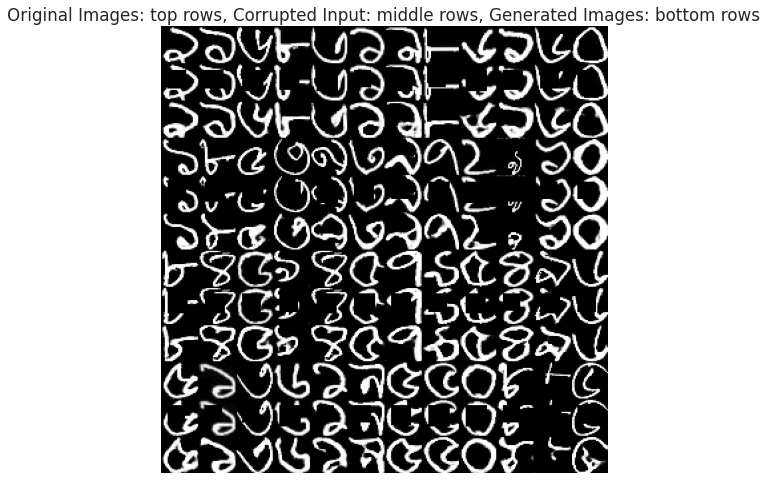

  1%|          | 2/191 [00:00<00:15, 12.23it/s]

Epoch 13


100%|██████████| 191/191 [00:13<00:00, 14.33it/s]

Discriminator Loss:  0.583891749382019 , Adversarial Loss:  1.1478713750839233
NOISED


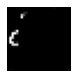

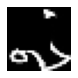

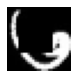

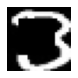

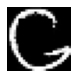

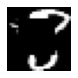

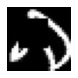

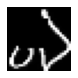

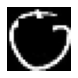

GENERATED


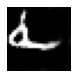

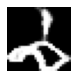

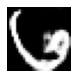

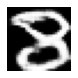

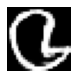

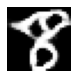

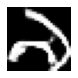

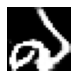

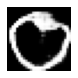

ORIGINAL


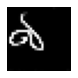

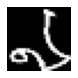

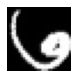

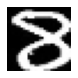

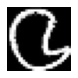

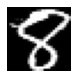

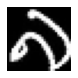

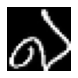

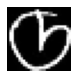

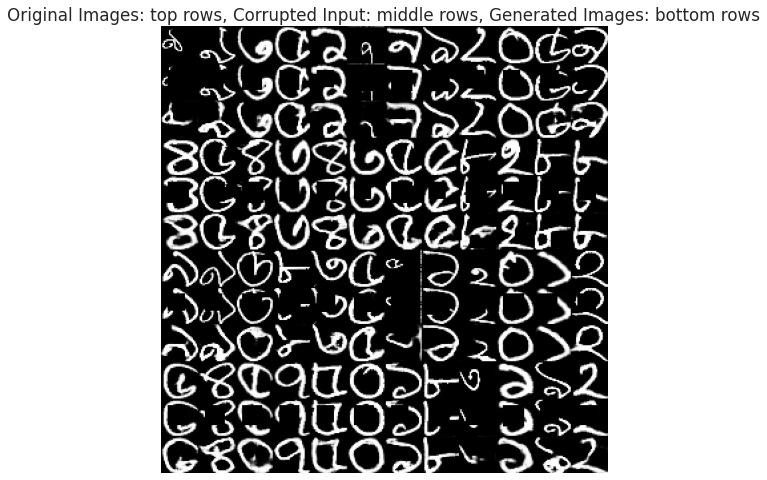

  1%|          | 1/191 [00:00<00:19,  9.66it/s]

Epoch 14


100%|██████████| 191/191 [00:12<00:00, 14.82it/s]


Discriminator Loss:  0.6543606519699097 , Adversarial Loss:  0.8896974921226501
NOISED


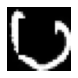

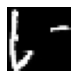

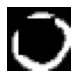

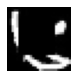

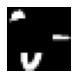

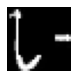

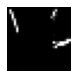

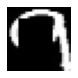

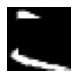

GENERATED


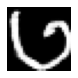

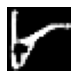

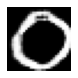

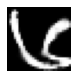

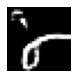

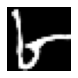

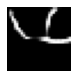

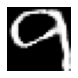

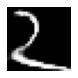

ORIGINAL


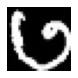

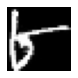

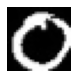

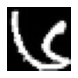

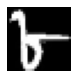

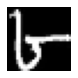

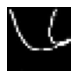

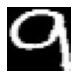

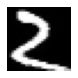

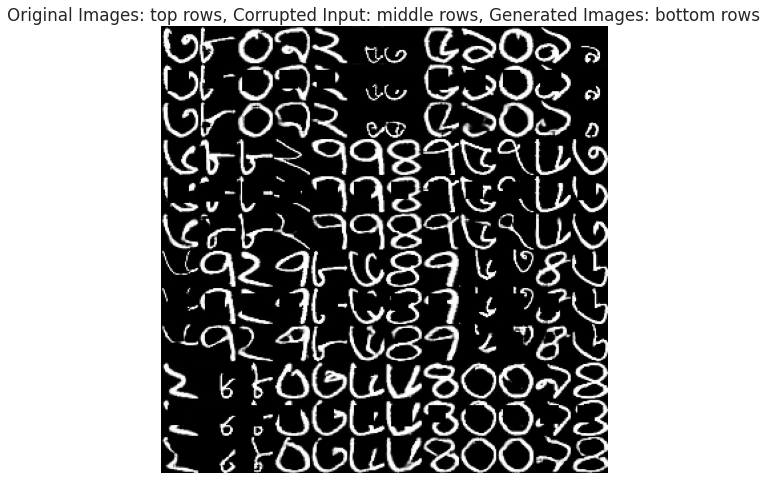

  1%|          | 2/191 [00:00<00:16, 11.50it/s]

Epoch 15


100%|██████████| 191/191 [00:12<00:00, 15.10it/s]


Discriminator Loss:  0.6217328310012817 , Adversarial Loss:  1.0787839889526367
NOISED


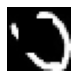

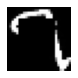

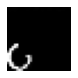

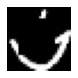

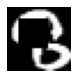

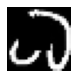

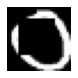

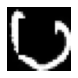

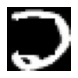

GENERATED


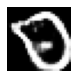

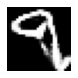

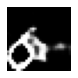

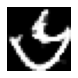

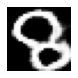

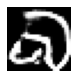

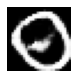

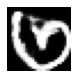

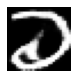

ORIGINAL


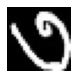

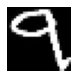

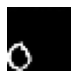

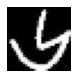

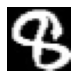

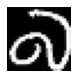

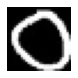

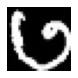

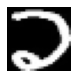

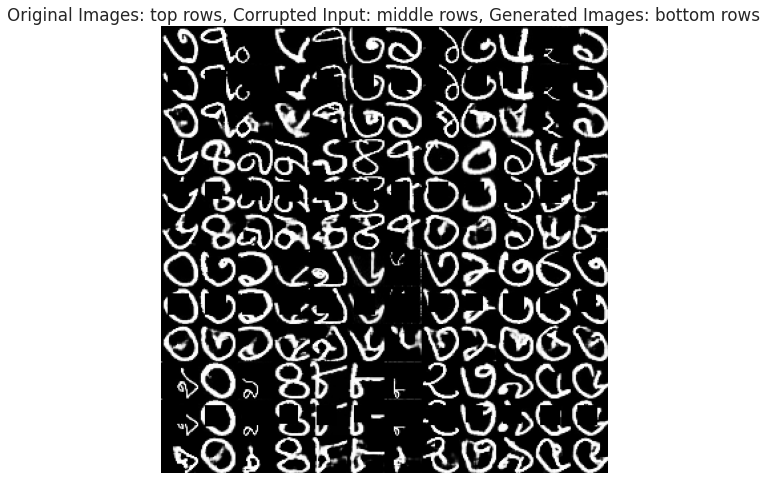

  1%|          | 2/191 [00:00<00:15, 12.20it/s]

Epoch 16


100%|██████████| 191/191 [00:12<00:00, 14.77it/s]

Discriminator Loss:  0.5887163877487183 , Adversarial Loss:  1.0980970859527588
NOISED


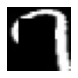

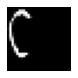

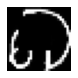

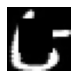

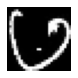

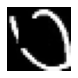

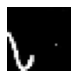

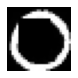

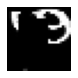

GENERATED


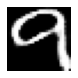

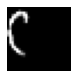

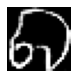

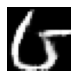

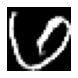

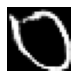

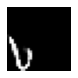

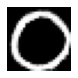

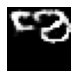

ORIGINAL


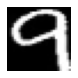

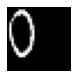

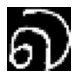

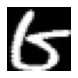

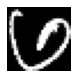

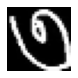

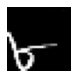

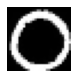

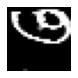

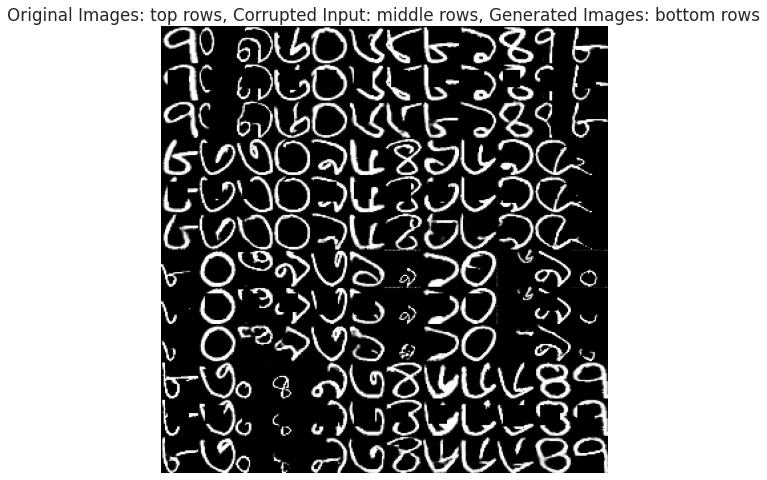

  1%|          | 2/191 [00:00<00:15, 12.44it/s]

Epoch 17


100%|██████████| 191/191 [00:12<00:00, 15.14it/s]

Discriminator Loss:  0.6340243816375732 , Adversarial Loss:  0.9968621730804443
NOISED


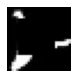

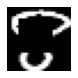

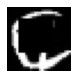

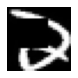

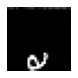

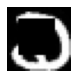

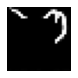

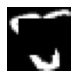

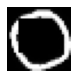

GENERATED


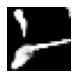

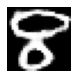

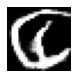

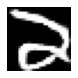

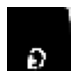

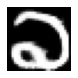

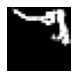

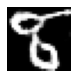

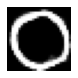

ORIGINAL


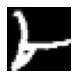

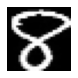

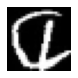

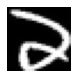

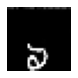

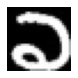

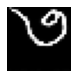

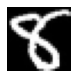

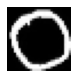

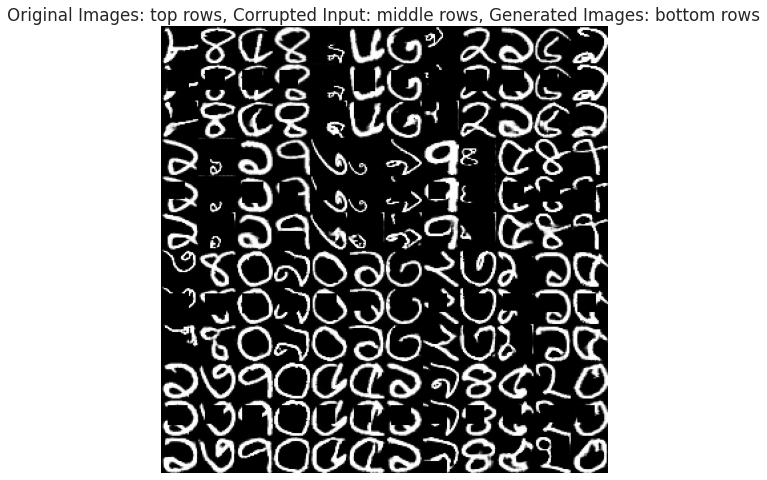

  1%|          | 2/191 [00:00<00:16, 11.47it/s]

Epoch 18


100%|██████████| 191/191 [00:12<00:00, 15.47it/s]


Discriminator Loss:  0.5895107388496399 , Adversarial Loss:  0.9739616513252258
NOISED


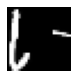

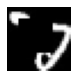

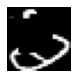

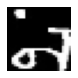

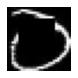

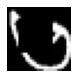

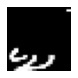

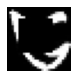

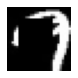

GENERATED


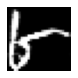

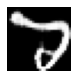

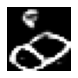

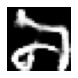

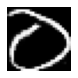

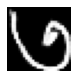

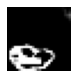

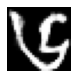

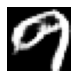

ORIGINAL


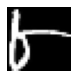

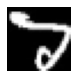

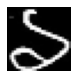

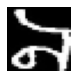

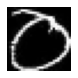

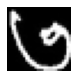

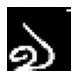

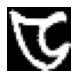

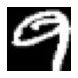

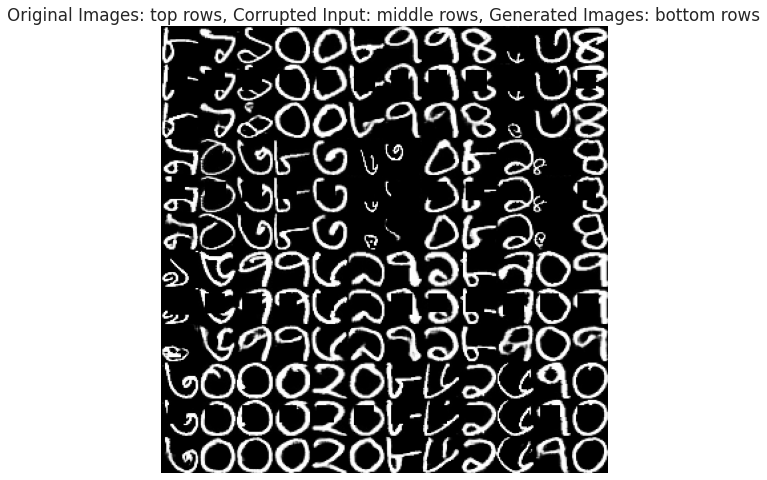

  1%|          | 2/191 [00:00<00:15, 12.10it/s]

Epoch 19


100%|██████████| 191/191 [00:12<00:00, 15.16it/s]


Discriminator Loss:  0.6289358735084534 , Adversarial Loss:  1.0626899003982544
NOISED


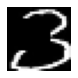

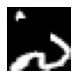

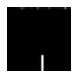

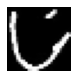

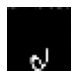

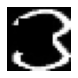

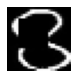

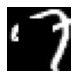

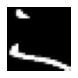

GENERATED


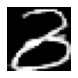

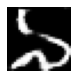

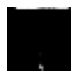

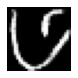

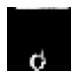

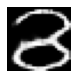

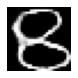

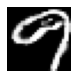

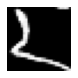

ORIGINAL


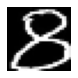

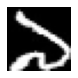

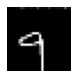

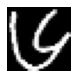

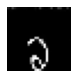

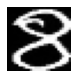

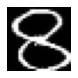

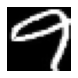

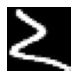

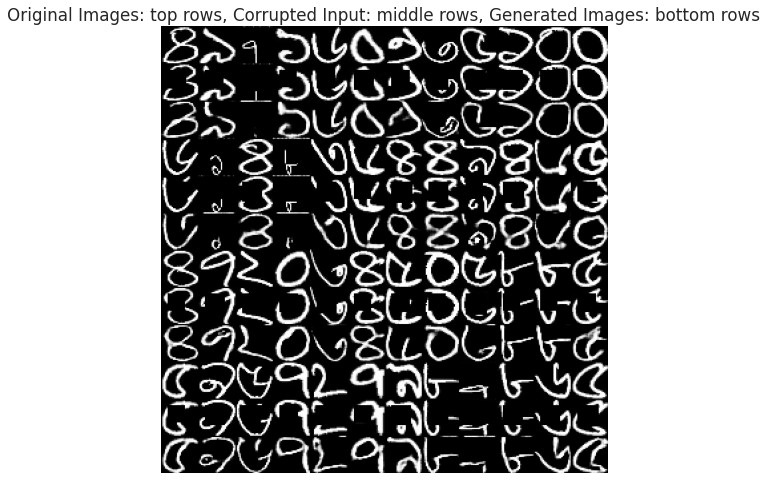

  1%|          | 2/191 [00:00<00:16, 11.67it/s]

Epoch 20


100%|██████████| 191/191 [00:12<00:00, 15.22it/s]


Discriminator Loss:  0.6889041662216187 , Adversarial Loss:  0.9957435131072998
NOISED


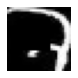

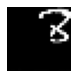

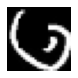

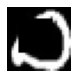

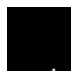

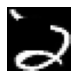

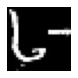

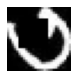

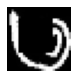

GENERATED


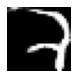

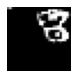

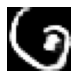

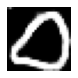

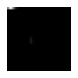

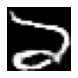

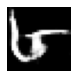

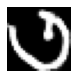

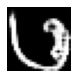

ORIGINAL


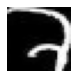

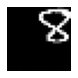

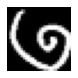

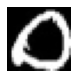

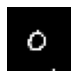

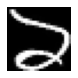

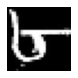

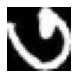

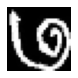

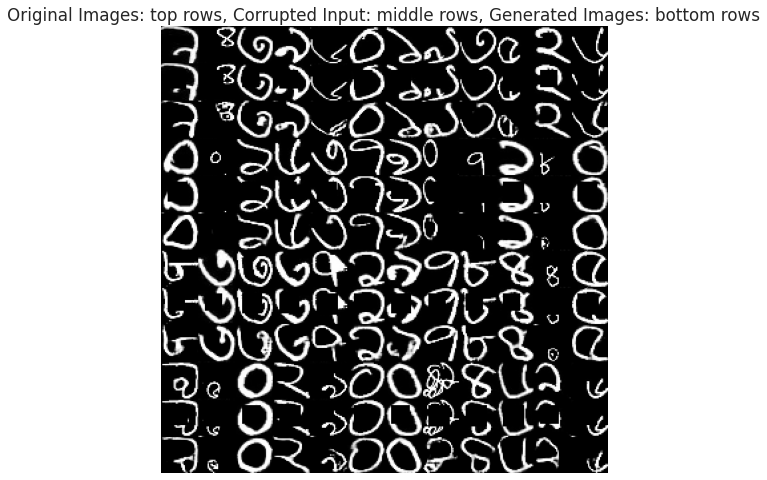

  1%|          | 1/191 [00:00<00:19,  9.56it/s]

Epoch 21


100%|██████████| 191/191 [00:12<00:00, 15.02it/s]


Discriminator Loss:  0.5800908207893372 , Adversarial Loss:  0.9403465986251831
NOISED


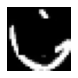

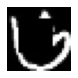

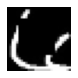

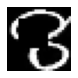

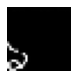

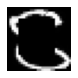

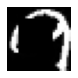

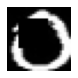

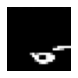

GENERATED


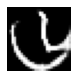

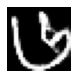

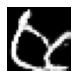

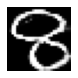

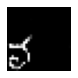

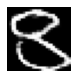

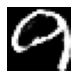

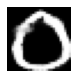

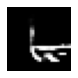

ORIGINAL


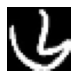

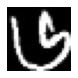

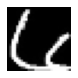

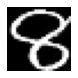

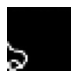

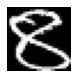

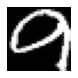

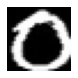

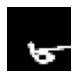

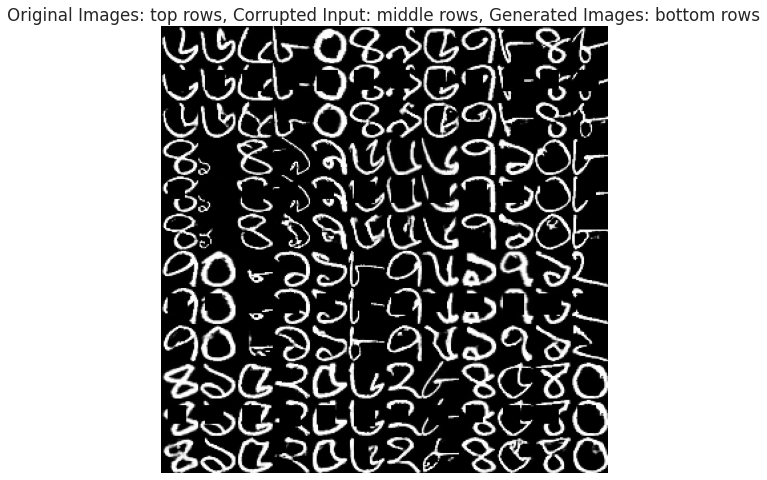

  1%|          | 2/191 [00:00<00:18, 10.49it/s]

Epoch 22


100%|██████████| 191/191 [00:12<00:00, 15.02it/s]


Discriminator Loss:  0.6041660308837891 , Adversarial Loss:  0.997545063495636
NOISED


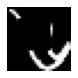

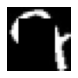

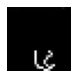

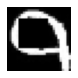

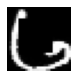

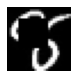

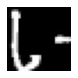

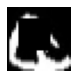

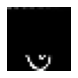

GENERATED


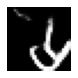

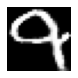

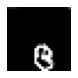

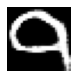

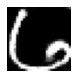

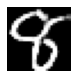

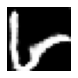

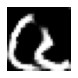

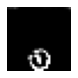

ORIGINAL


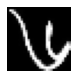

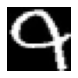

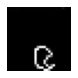

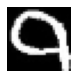

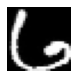

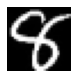

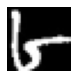

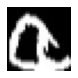

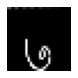

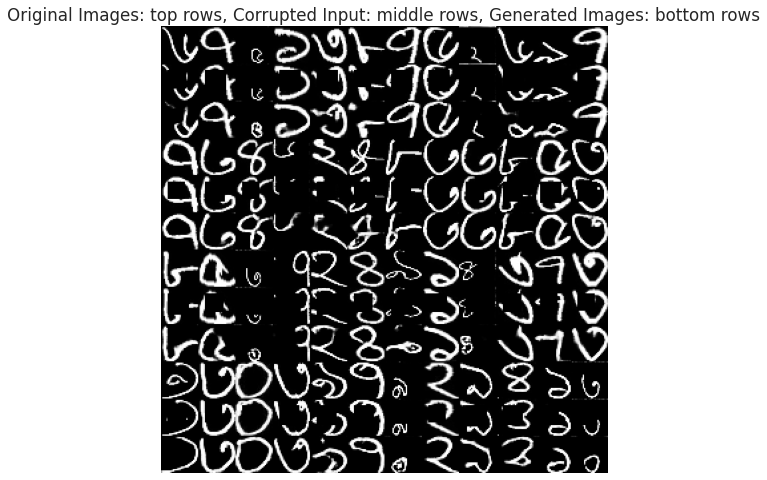

  1%|          | 2/191 [00:00<00:16, 11.71it/s]

Epoch 23


100%|██████████| 191/191 [00:12<00:00, 14.71it/s]


Discriminator Loss:  0.5985546708106995 , Adversarial Loss:  1.0613062381744385
NOISED


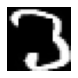

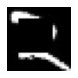

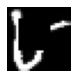

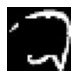

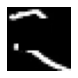

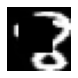

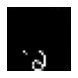

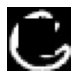

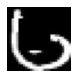

GENERATED


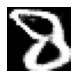

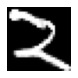

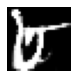

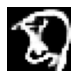

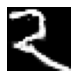

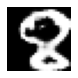

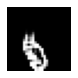

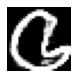

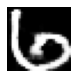

ORIGINAL


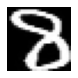

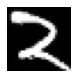

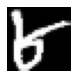

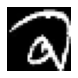

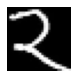

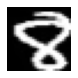

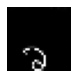

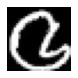

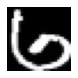

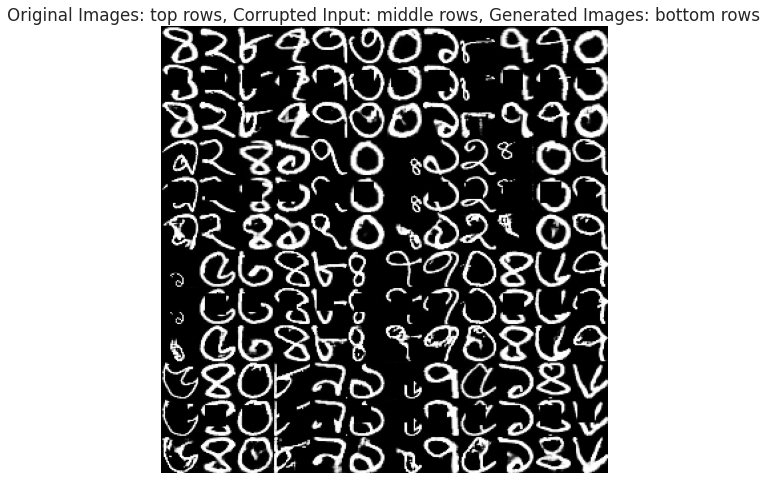

  1%|          | 2/191 [00:00<00:15, 11.95it/s]

Epoch 24


100%|██████████| 191/191 [00:13<00:00, 14.56it/s]


Discriminator Loss:  0.6257750988006592 , Adversarial Loss:  0.9144058227539062
NOISED


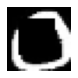

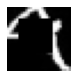

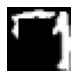

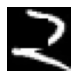

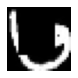

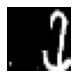

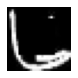

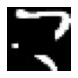

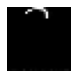

GENERATED


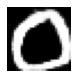

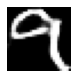

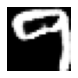

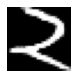

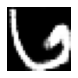

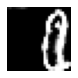

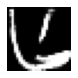

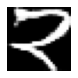

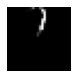

ORIGINAL


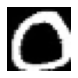

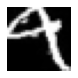

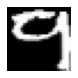

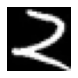

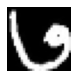

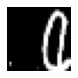

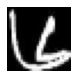

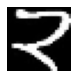

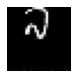

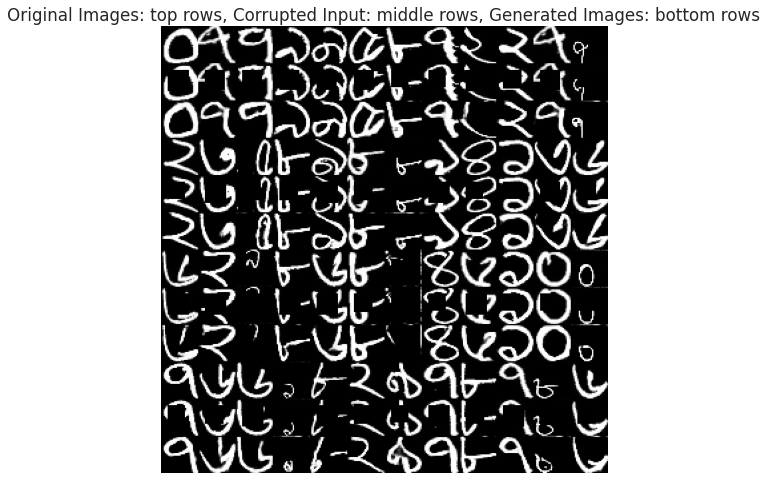

  1%|          | 2/191 [00:00<00:17, 11.00it/s]

Epoch 25


100%|██████████| 191/191 [00:12<00:00, 15.04it/s]


Discriminator Loss:  0.6351099610328674 , Adversarial Loss:  1.018014907836914
NOISED


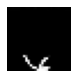

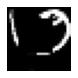

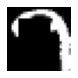

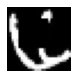

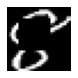

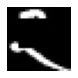

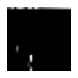

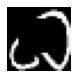

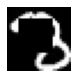

GENERATED


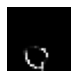

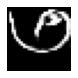

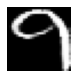

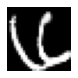

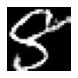

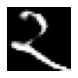

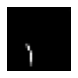

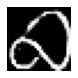

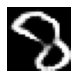

ORIGINAL


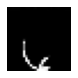

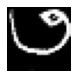

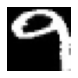

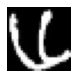

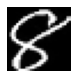

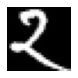

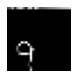

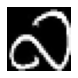

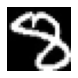

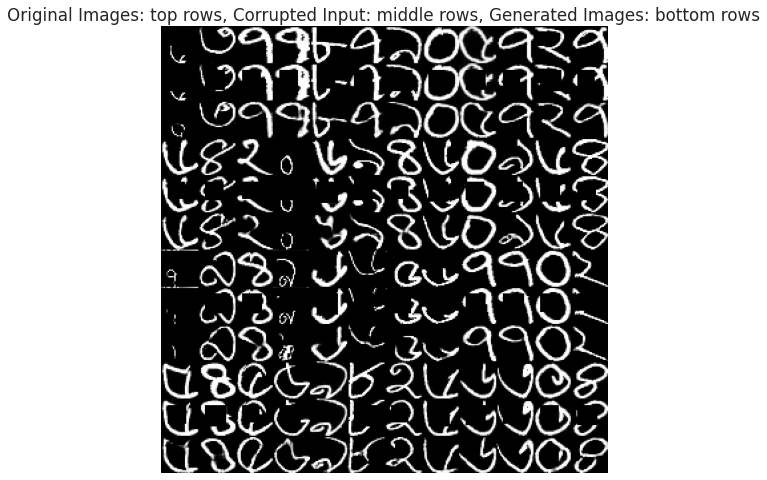

  1%|          | 2/191 [00:00<00:16, 11.60it/s]

Epoch 26


100%|██████████| 191/191 [00:12<00:00, 15.26it/s]


Discriminator Loss:  0.6221762299537659 , Adversarial Loss:  0.939206600189209
NOISED


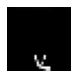

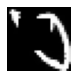

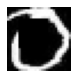

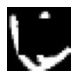

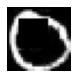

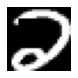

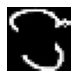

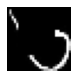

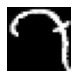

GENERATED


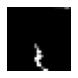

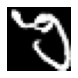

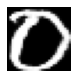

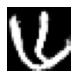

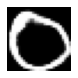

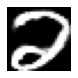

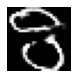

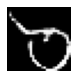

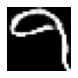

ORIGINAL


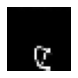

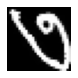

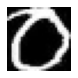

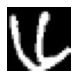

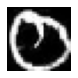

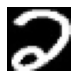

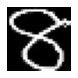

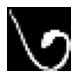

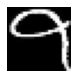

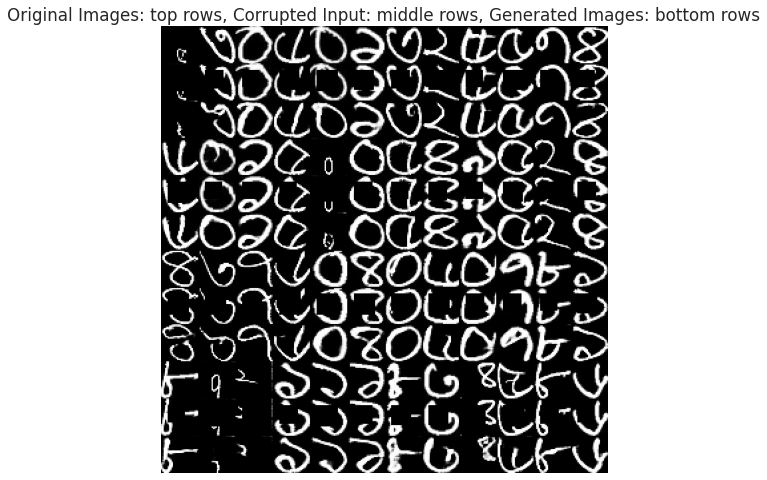

  1%|          | 2/191 [00:00<00:16, 11.37it/s]

Epoch 27


100%|██████████| 191/191 [00:12<00:00, 15.05it/s]


Discriminator Loss:  0.620204508304596 , Adversarial Loss:  0.962736964225769
NOISED


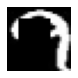

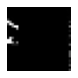

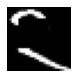

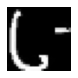

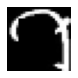

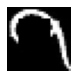

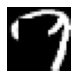

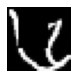

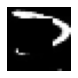

GENERATED


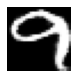

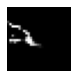

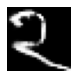

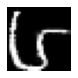

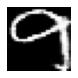

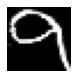

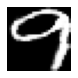

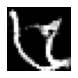

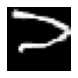

ORIGINAL


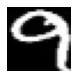

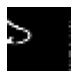

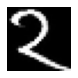

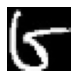

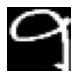

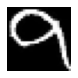

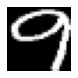

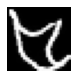

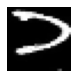

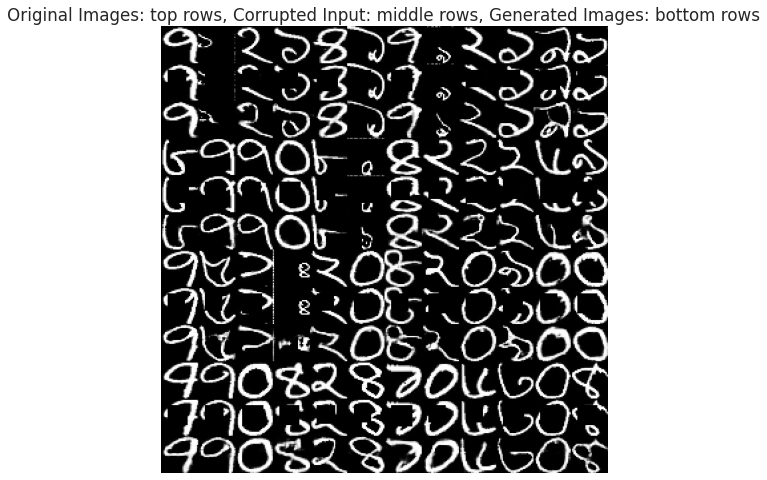

  1%|          | 2/191 [00:00<00:16, 11.78it/s]

Epoch 28


100%|██████████| 191/191 [00:12<00:00, 15.09it/s]


Discriminator Loss:  0.6214162111282349 , Adversarial Loss:  1.029688835144043
NOISED


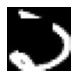

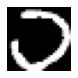

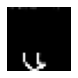

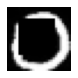

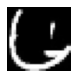

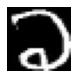

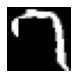

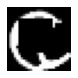

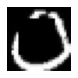

GENERATED


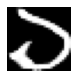

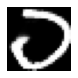

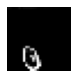

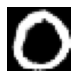

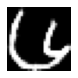

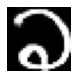

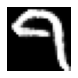

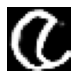

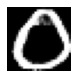

ORIGINAL


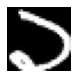

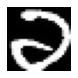

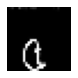

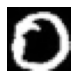

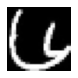

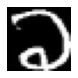

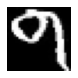

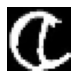

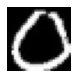

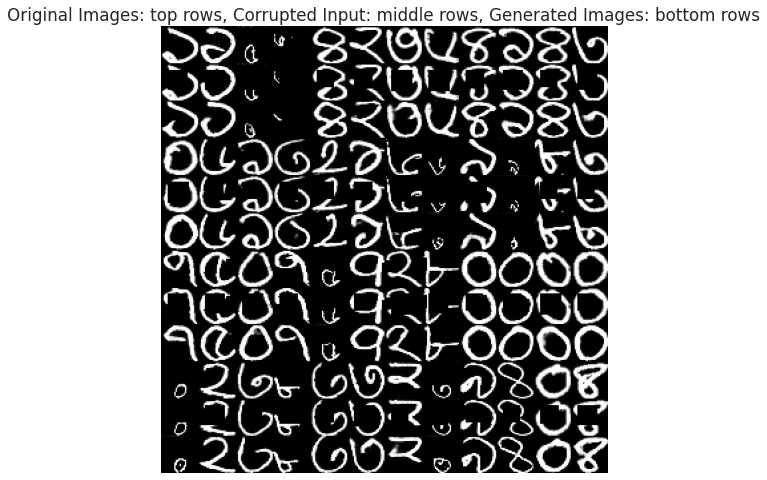

  1%|          | 2/191 [00:00<00:16, 11.77it/s]

Epoch 29


100%|██████████| 191/191 [00:12<00:00, 15.34it/s]


Discriminator Loss:  0.6597098112106323 , Adversarial Loss:  1.0350438356399536
NOISED


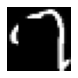

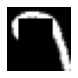

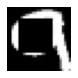

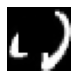

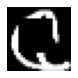

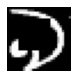

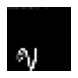

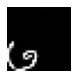

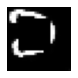

GENERATED


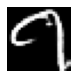

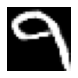

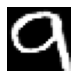

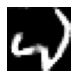

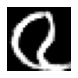

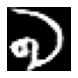

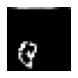

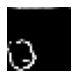

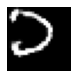

ORIGINAL


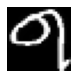

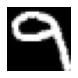

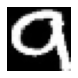

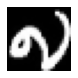

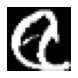

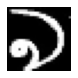

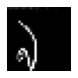

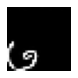

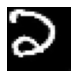

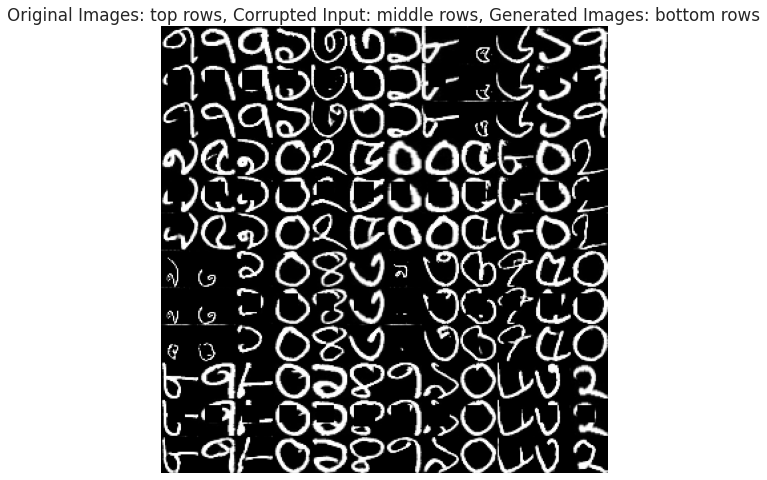

  1%|          | 1/191 [00:00<00:19,  9.98it/s]

Epoch 30


100%|██████████| 191/191 [00:12<00:00, 15.22it/s]


Discriminator Loss:  0.6444749236106873 , Adversarial Loss:  1.043175220489502
NOISED


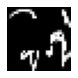

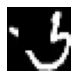

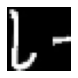

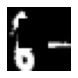

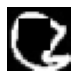

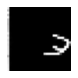

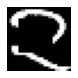

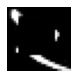

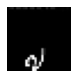

GENERATED


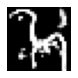

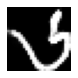

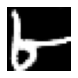

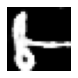

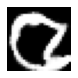

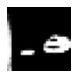

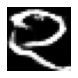

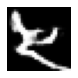

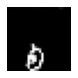

ORIGINAL


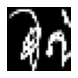

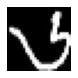

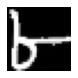

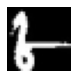

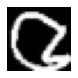

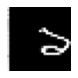

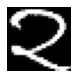

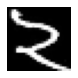

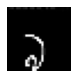

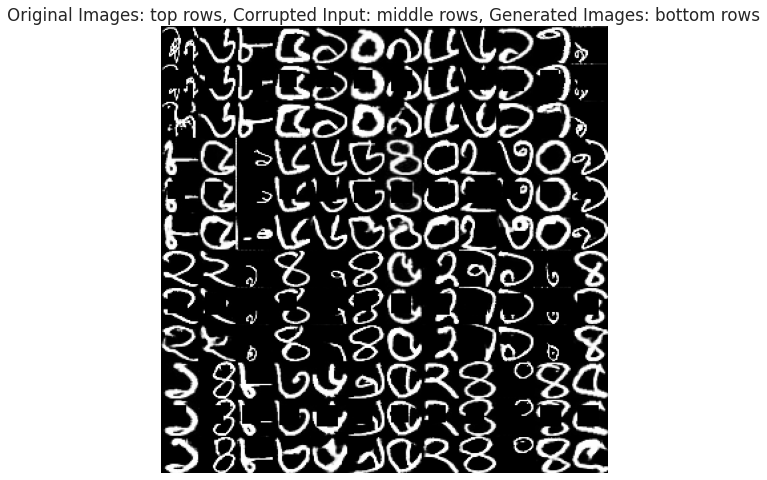

  1%|          | 2/191 [00:00<00:16, 11.73it/s]

Epoch 31


100%|██████████| 191/191 [00:12<00:00, 15.05it/s]


Discriminator Loss:  0.6488808393478394 , Adversarial Loss:  1.0214142799377441
NOISED


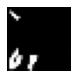

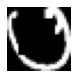

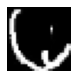

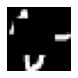

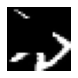

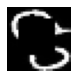

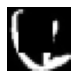

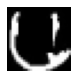

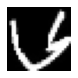

GENERATED


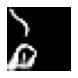

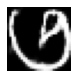

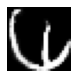

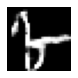

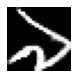

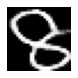

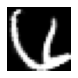

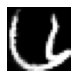

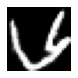

ORIGINAL


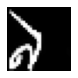

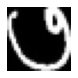

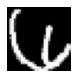

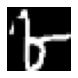

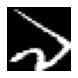

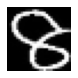

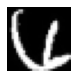

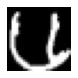

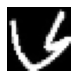

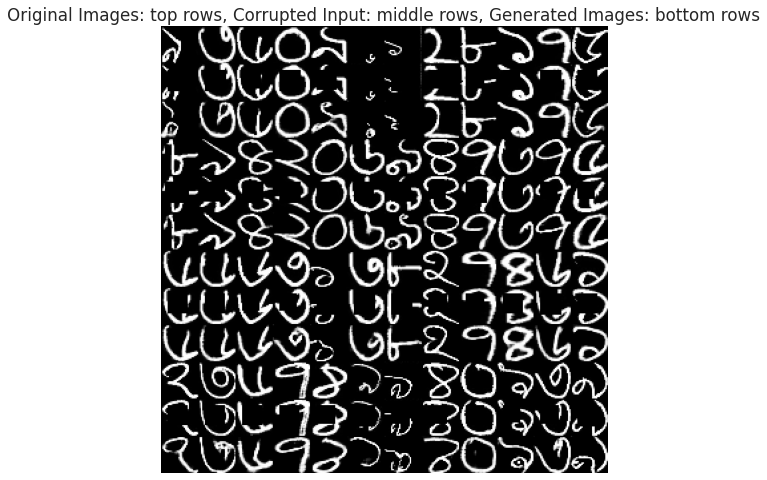

  1%|          | 2/191 [00:00<00:16, 11.41it/s]

Epoch 32


100%|██████████| 191/191 [00:12<00:00, 15.08it/s]


Discriminator Loss:  0.5042819380760193 , Adversarial Loss:  0.8028788566589355
NOISED


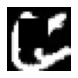

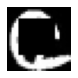

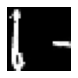

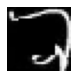

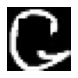

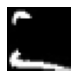

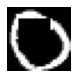

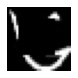

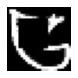

GENERATED


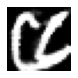

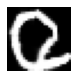

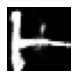

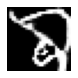

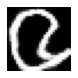

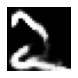

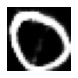

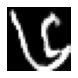

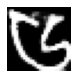

ORIGINAL


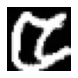

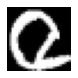

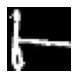

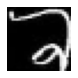

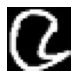

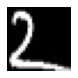

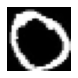

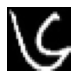

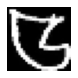

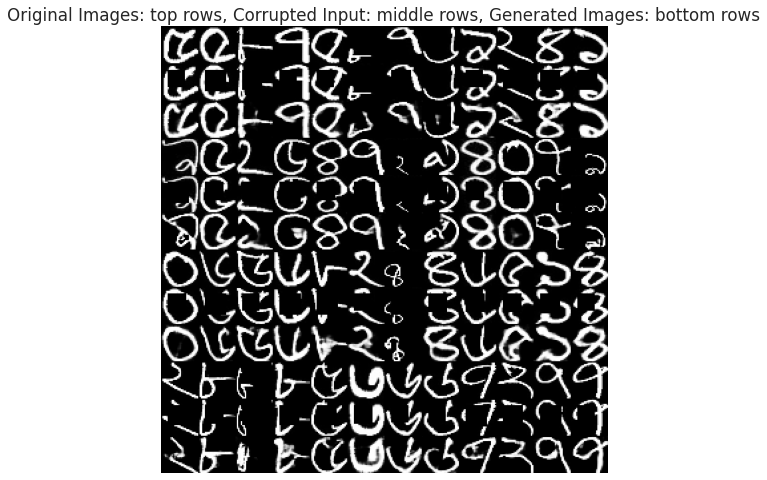

  1%|          | 2/191 [00:00<00:16, 11.47it/s]

Epoch 33


100%|██████████| 191/191 [00:12<00:00, 14.85it/s]


Discriminator Loss:  0.6426799893379211 , Adversarial Loss:  1.0049355030059814
NOISED


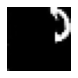

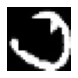

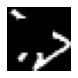

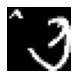

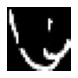

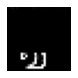

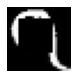

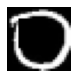

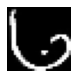

GENERATED


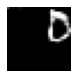

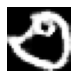

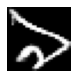

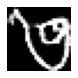

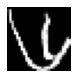

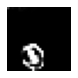

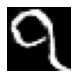

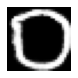

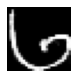

ORIGINAL


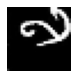

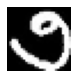

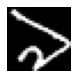

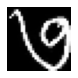

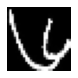

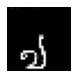

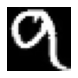

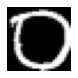

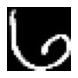

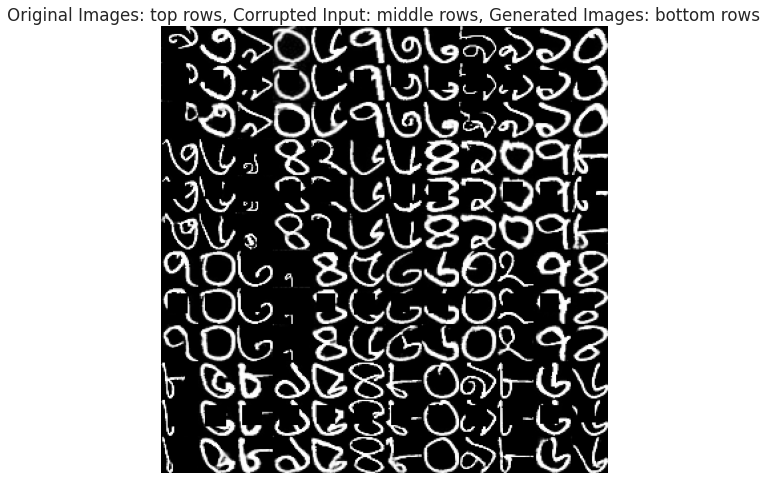

  1%|          | 2/191 [00:00<00:16, 11.41it/s]

Epoch 34


100%|██████████| 191/191 [00:12<00:00, 14.95it/s]

Discriminator Loss:  0.6163550019264221 , Adversarial Loss:  1.1049692630767822
NOISED


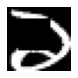

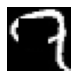

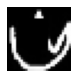

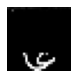

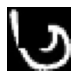

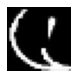

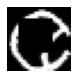

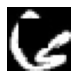

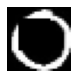

GENERATED


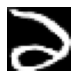

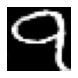

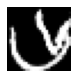

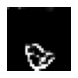

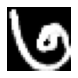

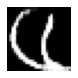

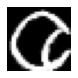

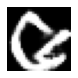

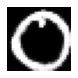

ORIGINAL


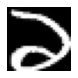

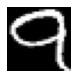

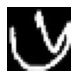

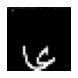

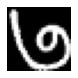

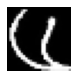

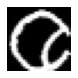

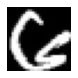

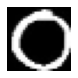

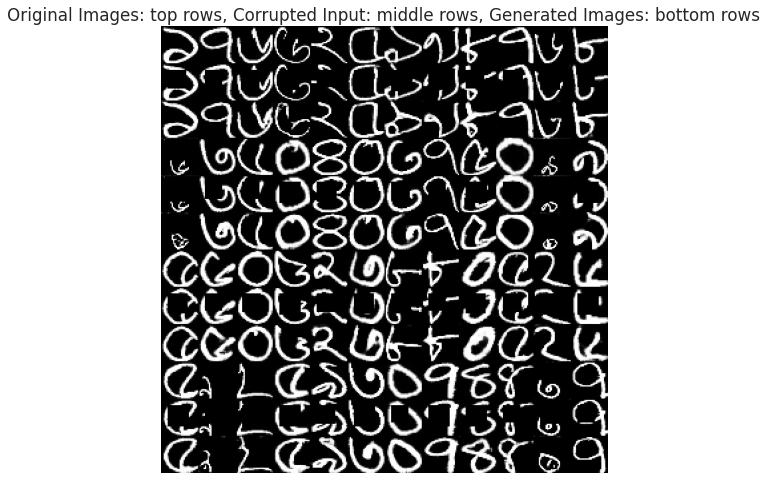

  1%|          | 2/191 [00:00<00:15, 11.84it/s]

Epoch 35


100%|██████████| 191/191 [00:12<00:00, 14.79it/s]


Discriminator Loss:  0.6169348955154419 , Adversarial Loss:  0.9127713441848755
NOISED


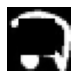

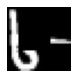

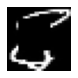

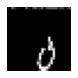

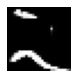

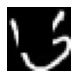

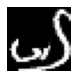

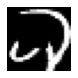

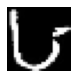

GENERATED


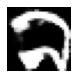

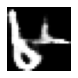

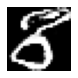

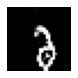

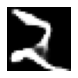

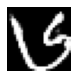

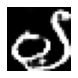

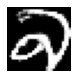

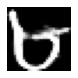

ORIGINAL


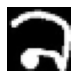

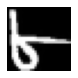

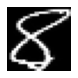

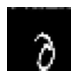

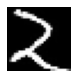

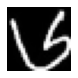

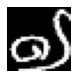

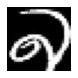

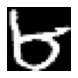

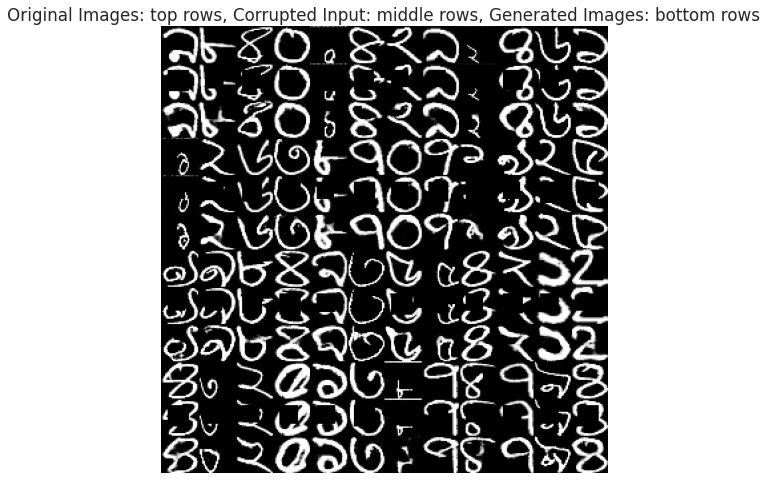

  1%|          | 2/191 [00:00<00:15, 11.96it/s]

Epoch 36


100%|██████████| 191/191 [00:12<00:00, 15.09it/s]


Discriminator Loss:  0.6412411332130432 , Adversarial Loss:  1.1003237962722778
NOISED


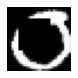

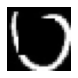

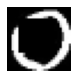

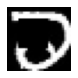

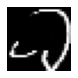

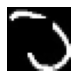

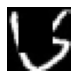

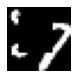

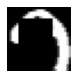

GENERATED


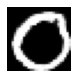

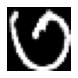

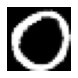

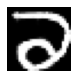

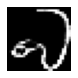

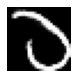

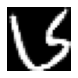

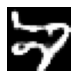

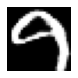

ORIGINAL


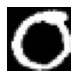

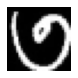

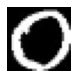

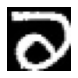

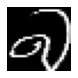

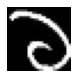

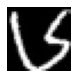

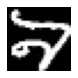

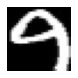

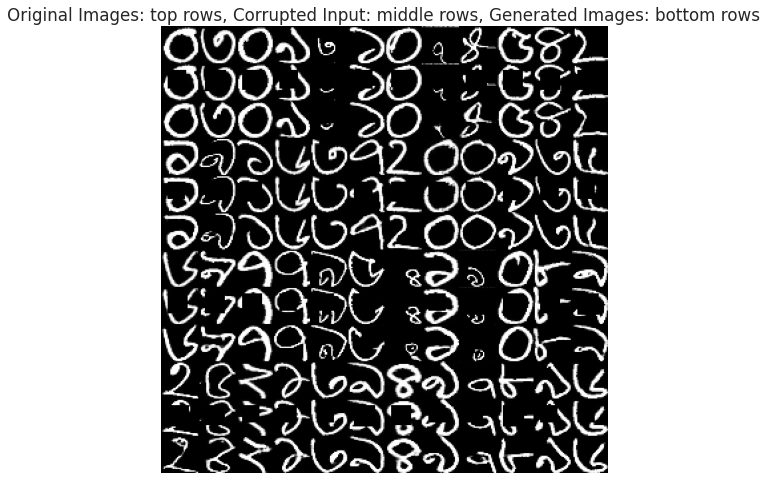

  1%|          | 2/191 [00:00<00:15, 12.19it/s]

Epoch 37


100%|██████████| 191/191 [00:12<00:00, 14.87it/s]


Discriminator Loss:  0.6120004653930664 , Adversarial Loss:  1.063178300857544
NOISED


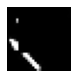

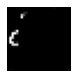

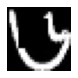

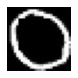

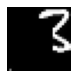

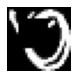

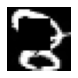

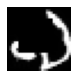

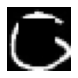

GENERATED


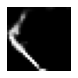

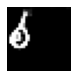

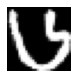

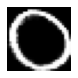

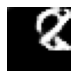

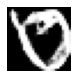

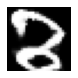

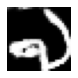

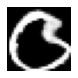

ORIGINAL


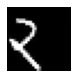

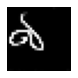

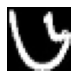

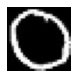

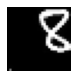

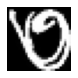

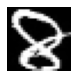

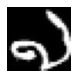

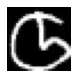

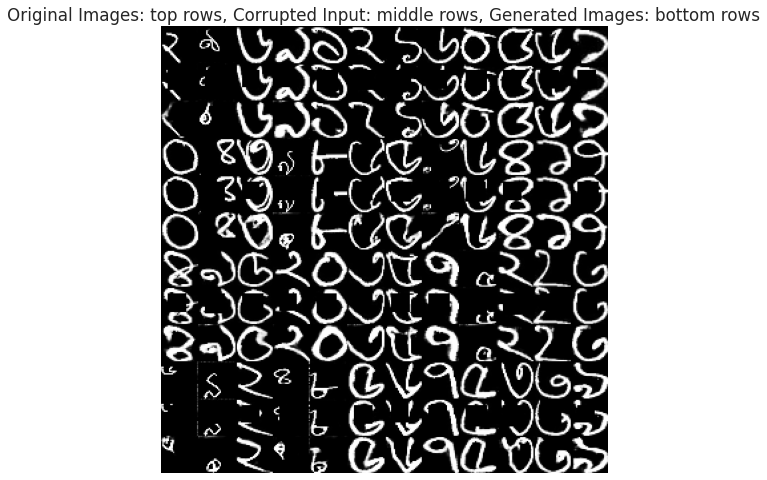

  1%|          | 2/191 [00:00<00:16, 11.55it/s]

Epoch 38


100%|██████████| 191/191 [00:12<00:00, 15.49it/s]


Discriminator Loss:  0.6402462720870972 , Adversarial Loss:  1.0004818439483643
NOISED


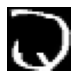

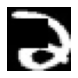

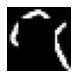

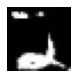

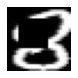

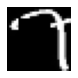

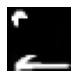

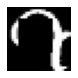

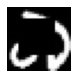

GENERATED


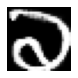

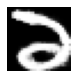

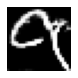

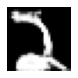

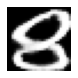

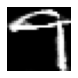

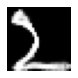

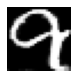

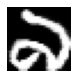

ORIGINAL


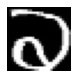

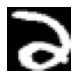

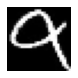

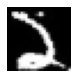

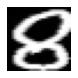

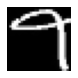

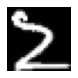

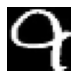

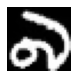

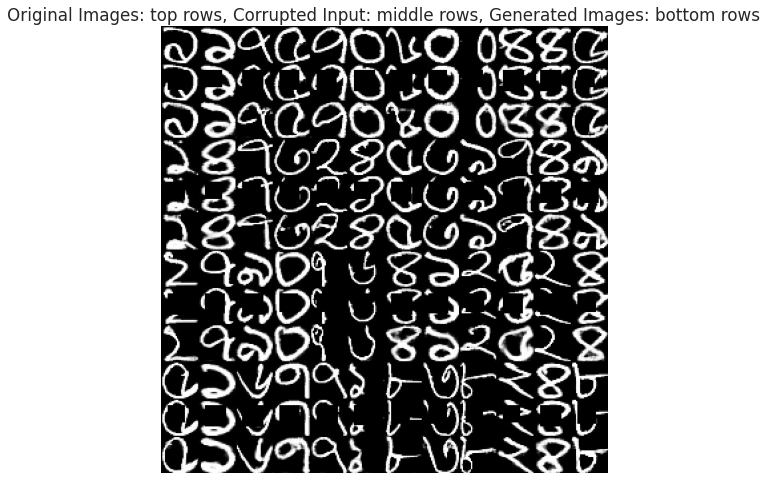

  1%|          | 2/191 [00:00<00:15, 12.00it/s]

Epoch 39


100%|██████████| 191/191 [00:12<00:00, 14.95it/s]


Discriminator Loss:  0.6437501311302185 , Adversarial Loss:  0.9733555316925049
NOISED


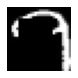

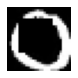

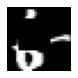

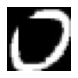

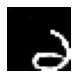

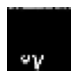

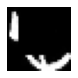

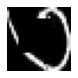

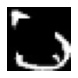

GENERATED


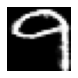

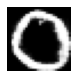

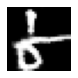

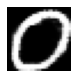

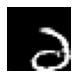

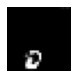

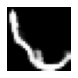

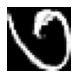

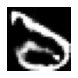

ORIGINAL


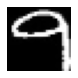

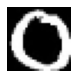

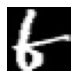

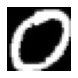

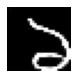

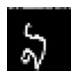

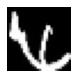

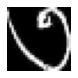

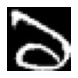

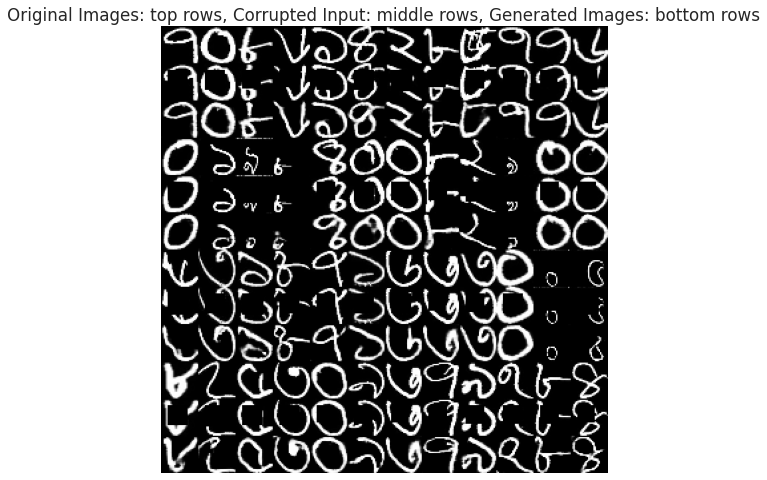

  1%|          | 2/191 [00:00<00:16, 11.45it/s]

Epoch 40


100%|██████████| 191/191 [00:12<00:00, 15.22it/s]

Discriminator Loss:  0.6154687404632568 , Adversarial Loss:  0.9339361190795898
NOISED


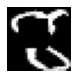

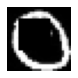

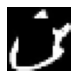

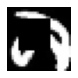

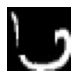

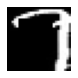

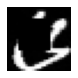

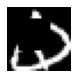

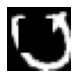

GENERATED


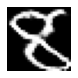

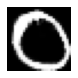

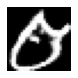

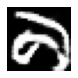

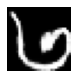

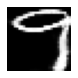

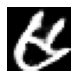

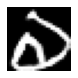

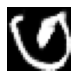

ORIGINAL


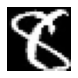

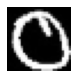

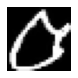

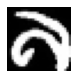

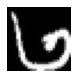

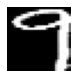

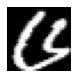

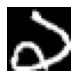

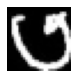

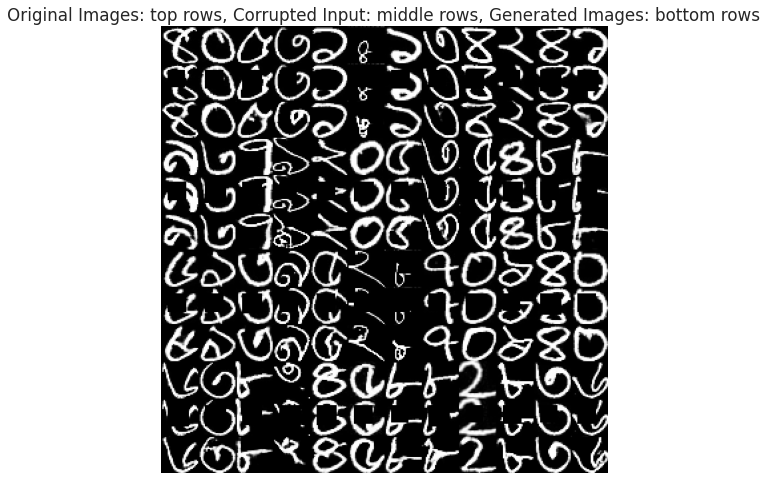

  1%|          | 1/191 [00:00<00:20,  9.42it/s]

Epoch 41


100%|██████████| 191/191 [00:12<00:00, 15.44it/s]


Discriminator Loss:  0.6191893815994263 , Adversarial Loss:  1.030662178993225
NOISED


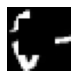

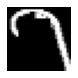

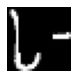

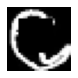

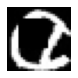

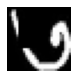

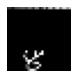

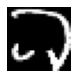

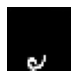

GENERATED


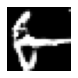

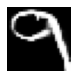

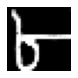

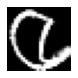

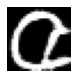

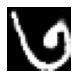

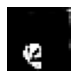

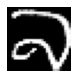

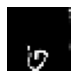

ORIGINAL


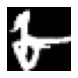

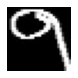

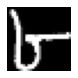

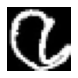

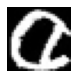

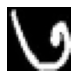

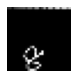

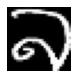

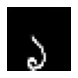

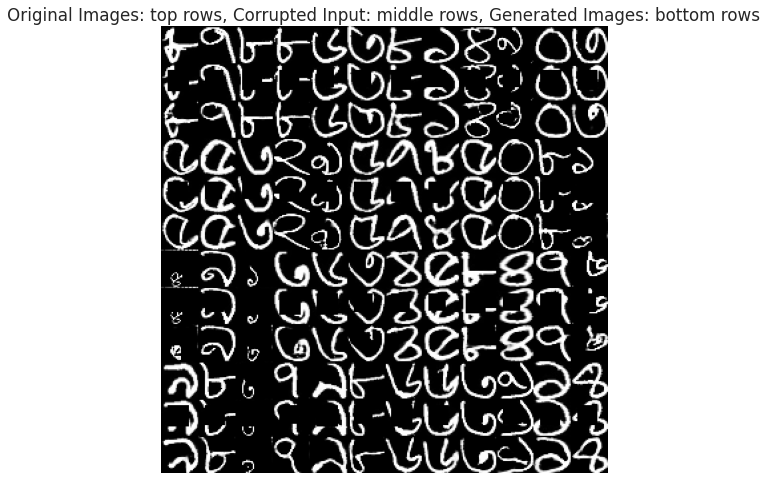

  1%|          | 1/191 [00:00<00:19,  9.89it/s]

Epoch 42


100%|██████████| 191/191 [00:12<00:00, 14.77it/s]


Discriminator Loss:  0.6439779996871948 , Adversarial Loss:  1.0222203731536865
NOISED


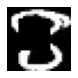

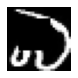

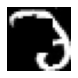

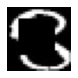

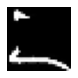

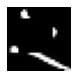

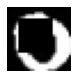

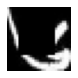

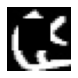

GENERATED


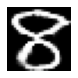

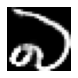

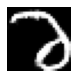

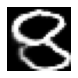

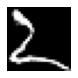

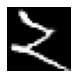

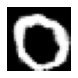

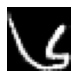

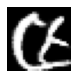

ORIGINAL


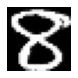

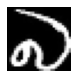

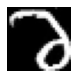

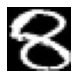

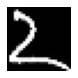

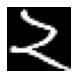

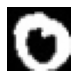

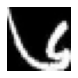

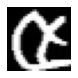

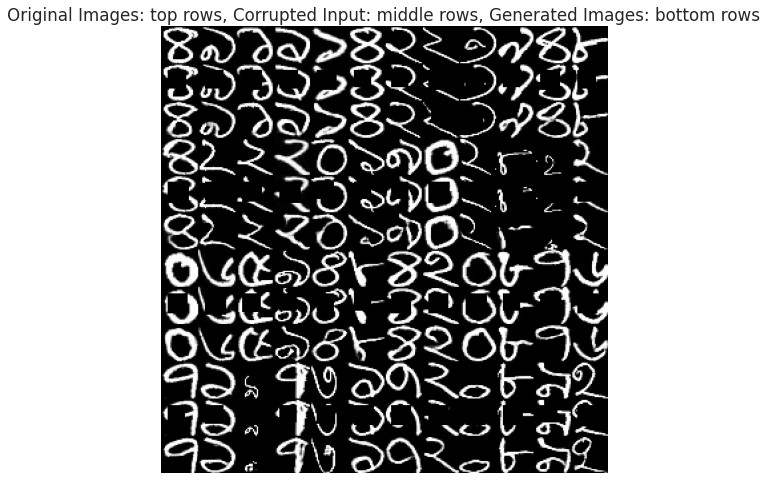

  1%|          | 2/191 [00:00<00:15, 12.02it/s]

Epoch 43


100%|██████████| 191/191 [00:12<00:00, 14.93it/s]


Discriminator Loss:  0.6459125876426697 , Adversarial Loss:  1.0976872444152832
NOISED


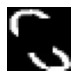

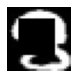

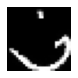

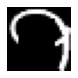

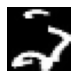

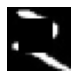

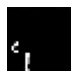

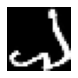

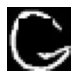

GENERATED


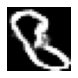

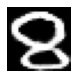

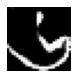

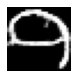

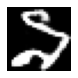

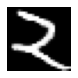

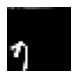

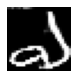

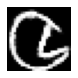

ORIGINAL


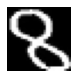

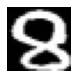

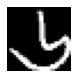

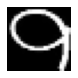

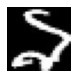

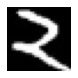

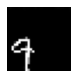

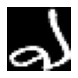

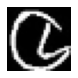

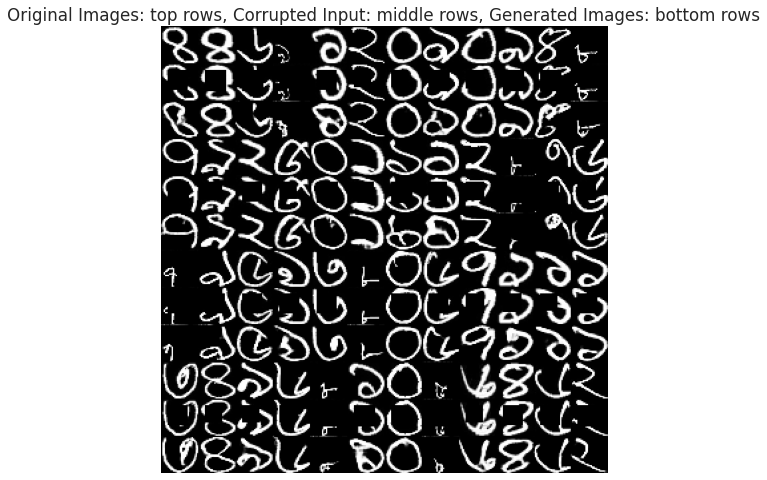

  1%|          | 2/191 [00:00<00:15, 12.15it/s]

Epoch 44


100%|██████████| 191/191 [00:12<00:00, 14.95it/s]


Discriminator Loss:  0.6356807351112366 , Adversarial Loss:  0.933766782283783
NOISED


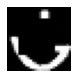

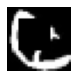

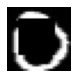

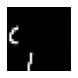

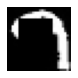

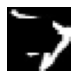

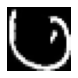

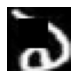

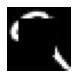

GENERATED


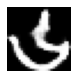

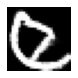

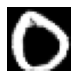

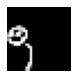

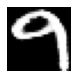

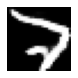

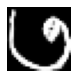

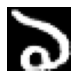

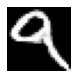

ORIGINAL


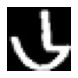

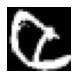

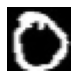

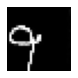

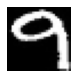

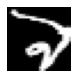

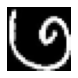

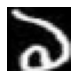

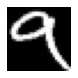

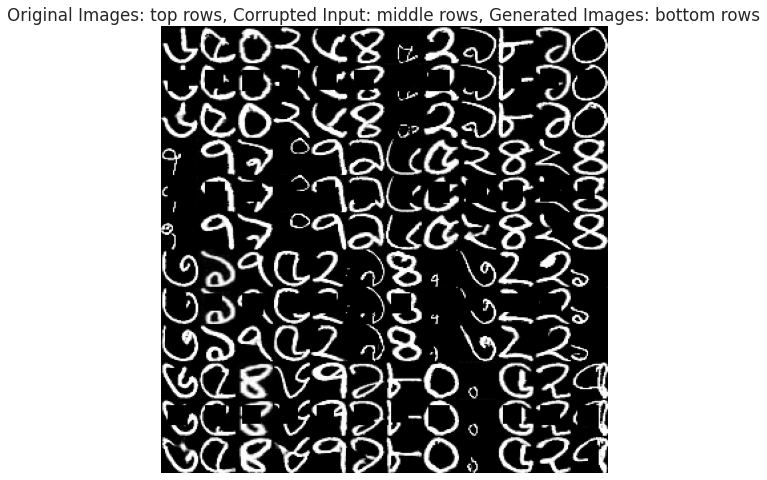

  1%|          | 2/191 [00:00<00:16, 11.80it/s]

Epoch 45


100%|██████████| 191/191 [00:12<00:00, 14.79it/s]

Discriminator Loss:  0.609199583530426 , Adversarial Loss:  0.8294827342033386
NOISED


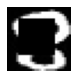

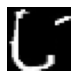

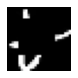

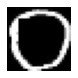

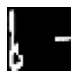

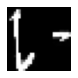

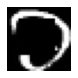

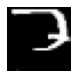

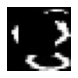

GENERATED


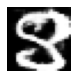

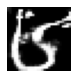

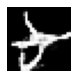

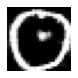

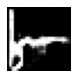

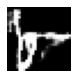

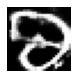

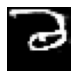

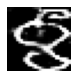

ORIGINAL


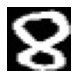

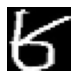

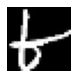

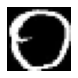

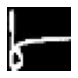

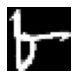

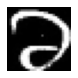

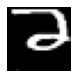

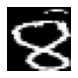

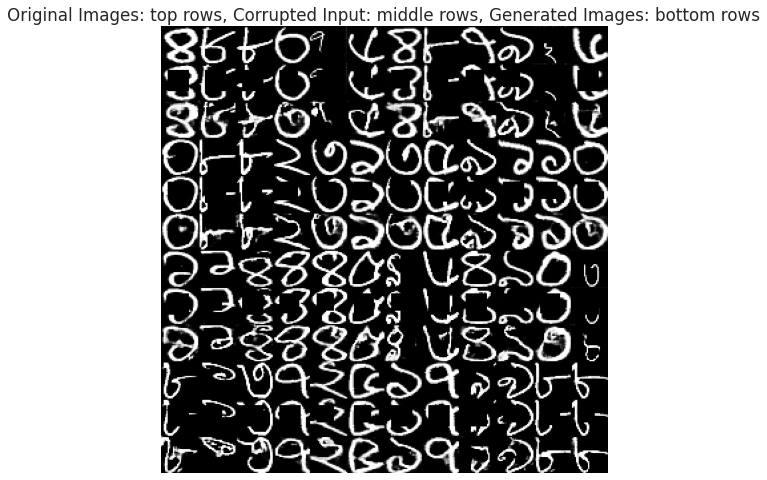

  1%|          | 2/191 [00:00<00:16, 11.43it/s]

Epoch 46


100%|██████████| 191/191 [00:12<00:00, 15.10it/s]


Discriminator Loss:  0.721291184425354 , Adversarial Loss:  0.9579131603240967
NOISED


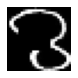

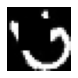

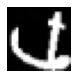

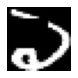

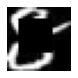

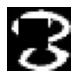

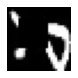

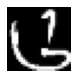

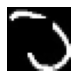

GENERATED


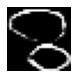

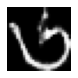

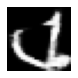

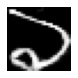

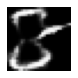

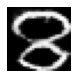

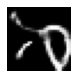

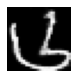

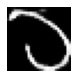

ORIGINAL


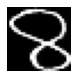

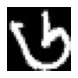

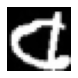

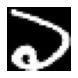

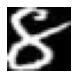

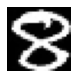

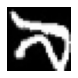

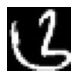

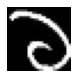

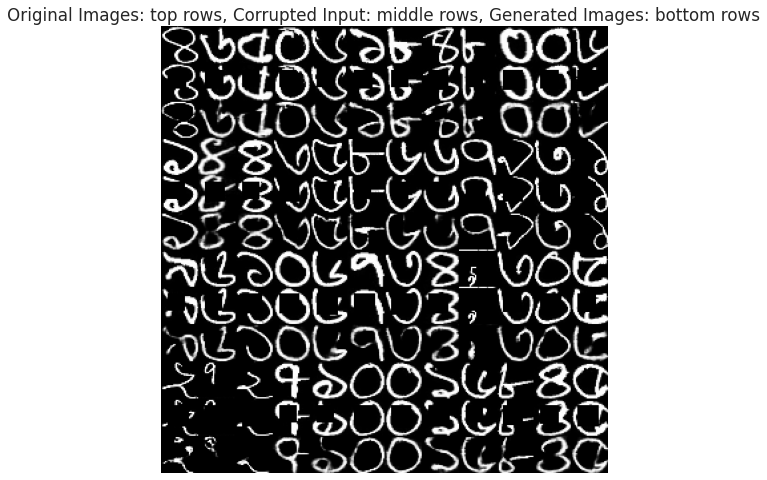

  1%|          | 2/191 [00:00<00:15, 11.95it/s]

Epoch 47


100%|██████████| 191/191 [00:13<00:00, 14.40it/s]


Discriminator Loss:  0.644422173500061 , Adversarial Loss:  0.998454213142395
NOISED


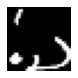

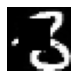

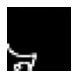

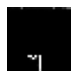

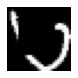

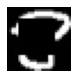

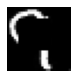

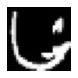

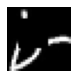

GENERATED


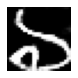

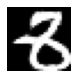

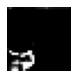

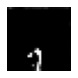

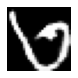

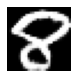

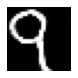

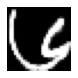

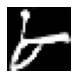

ORIGINAL


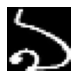

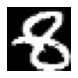

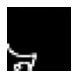

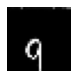

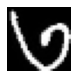

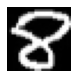

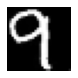

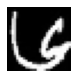

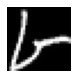

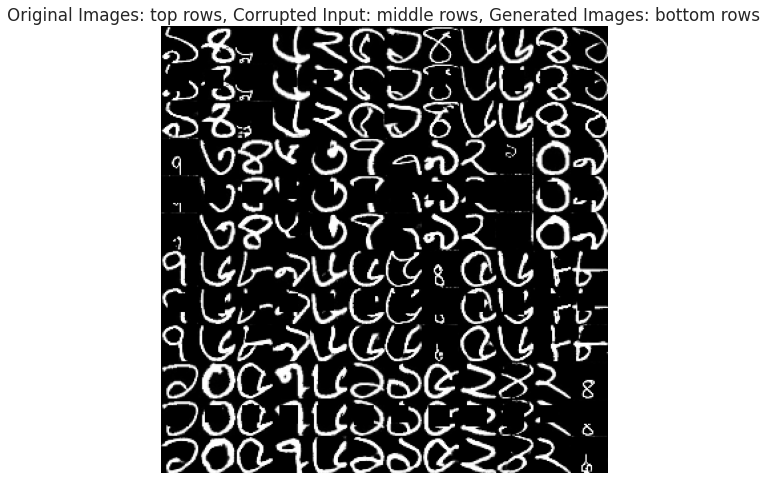

  1%|          | 2/191 [00:00<00:15, 12.12it/s]

Epoch 48


100%|██████████| 191/191 [00:12<00:00, 15.36it/s]

Discriminator Loss:  0.6323326826095581 , Adversarial Loss:  1.1287603378295898
NOISED


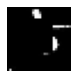

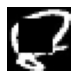

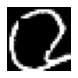

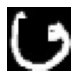

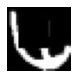

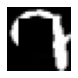

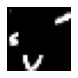

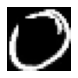

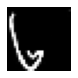

GENERATED


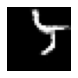

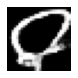

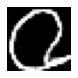

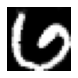

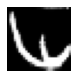

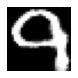

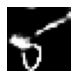

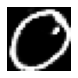

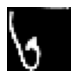

ORIGINAL


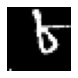

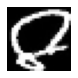

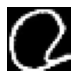

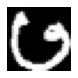

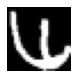

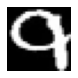

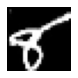

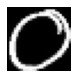

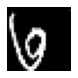

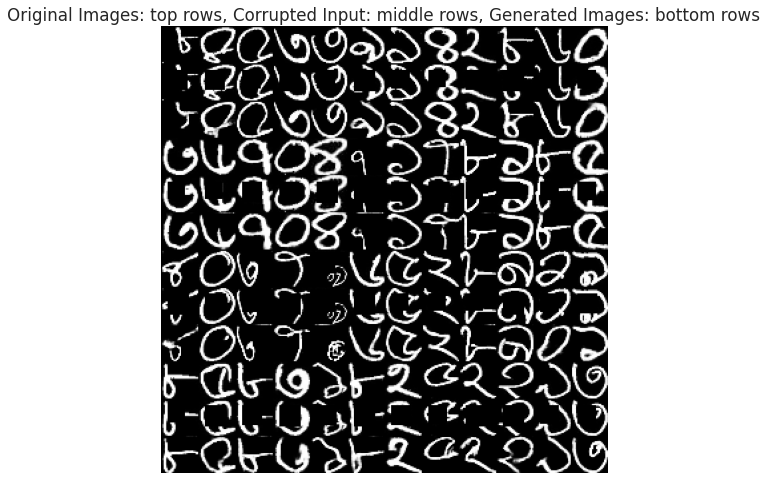

  1%|          | 2/191 [00:00<00:17, 10.90it/s]

Epoch 49


100%|██████████| 191/191 [00:12<00:00, 15.19it/s]


Discriminator Loss:  0.6467556953430176 , Adversarial Loss:  1.0590896606445312
NOISED


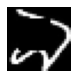

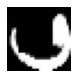

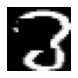

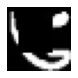

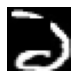

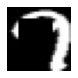

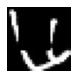

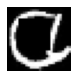

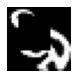

GENERATED


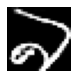

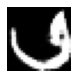

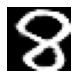

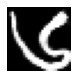

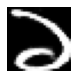

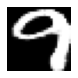

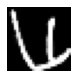

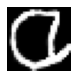

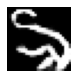

ORIGINAL


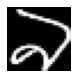

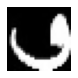

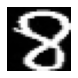

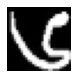

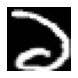

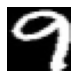

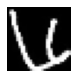

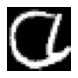

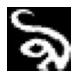

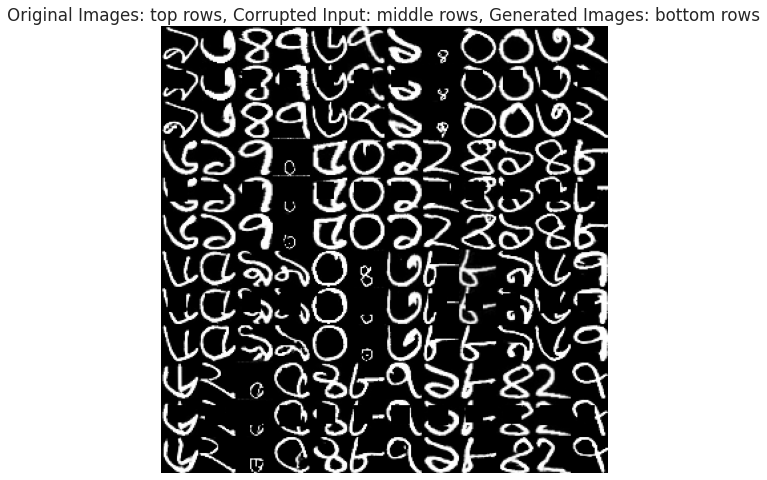

  0%|          | 0/191 [00:00<?, ?it/s]

Epoch 50


100%|██████████| 191/191 [00:12<00:00, 14.77it/s]


Discriminator Loss:  0.6434849500656128 , Adversarial Loss:  1.0762829780578613
NOISED


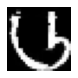

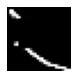

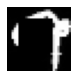

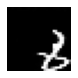

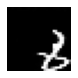

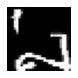

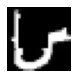

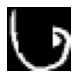

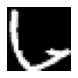

GENERATED


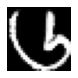

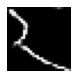

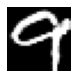

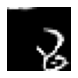

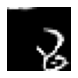

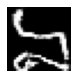

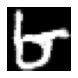

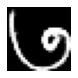

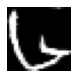

ORIGINAL


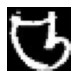

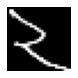

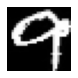

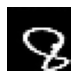

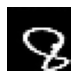

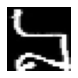

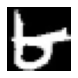

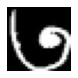

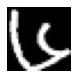

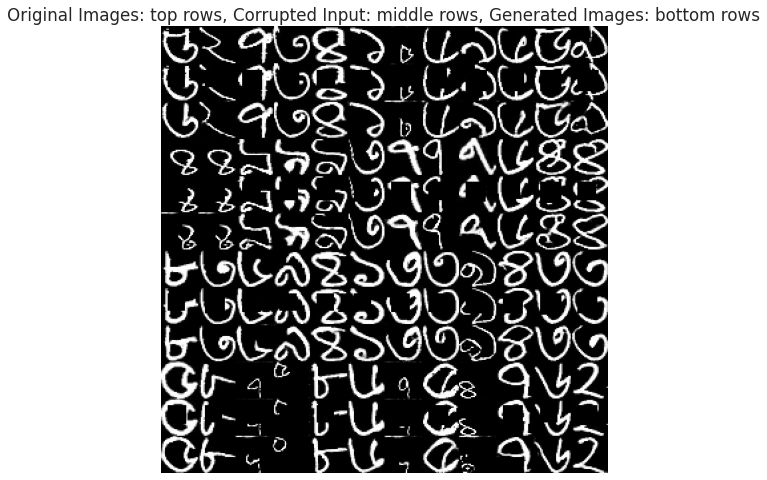

  1%|          | 1/191 [00:00<00:21,  8.85it/s]

Epoch 51


100%|██████████| 191/191 [00:12<00:00, 15.21it/s]


Discriminator Loss:  0.5930043458938599 , Adversarial Loss:  1.1019763946533203
NOISED


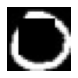

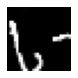

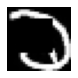

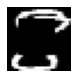

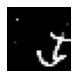

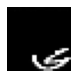

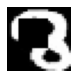

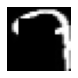

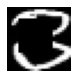

GENERATED


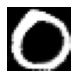

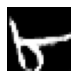

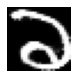

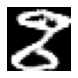

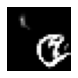

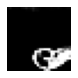

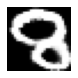

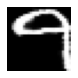

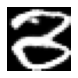

ORIGINAL


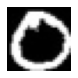

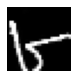

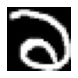

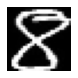

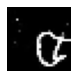

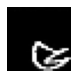

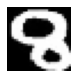

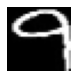

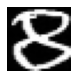

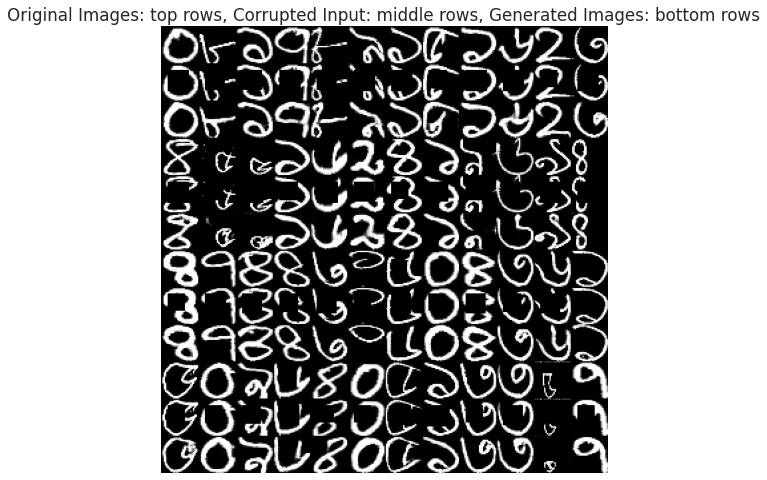

  1%|          | 2/191 [00:00<00:15, 12.06it/s]

Epoch 52


100%|██████████| 191/191 [00:12<00:00, 14.72it/s]


Discriminator Loss:  0.43319788575172424 , Adversarial Loss:  0.7490975260734558
NOISED


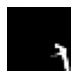

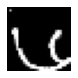

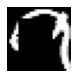

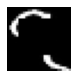

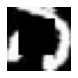

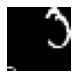

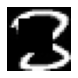

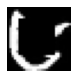

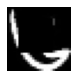

GENERATED


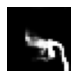

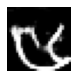

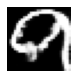

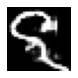

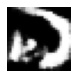

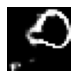

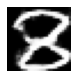

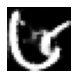

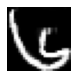

ORIGINAL


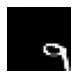

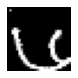

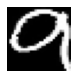

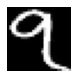

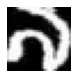

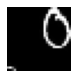

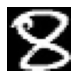

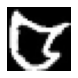

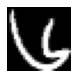

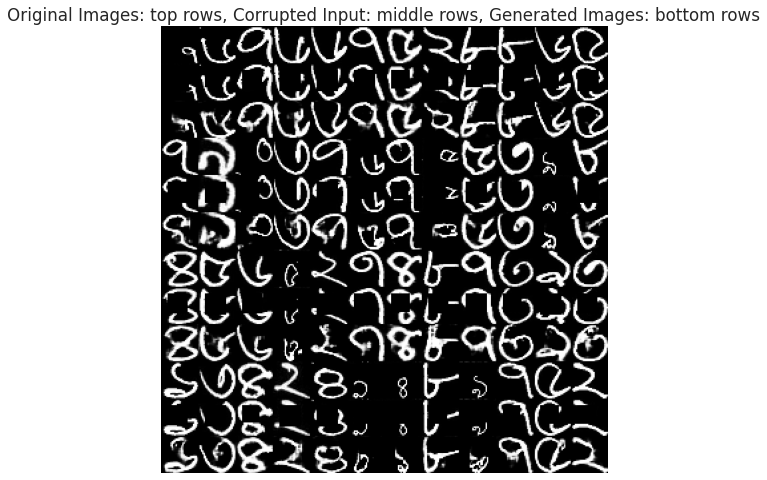

  1%|          | 2/191 [00:00<00:16, 11.59it/s]

Epoch 53


100%|██████████| 191/191 [00:12<00:00, 14.96it/s]

Discriminator Loss:  0.6556093692779541 , Adversarial Loss:  0.8390325307846069
NOISED


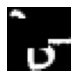

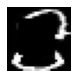

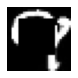

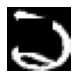

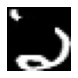

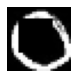

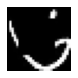

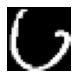

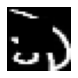

GENERATED


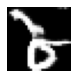

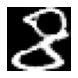

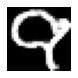

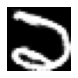

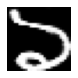

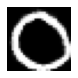

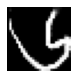

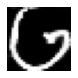

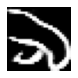

ORIGINAL


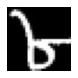

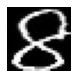

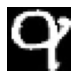

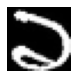

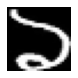

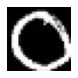

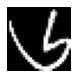

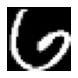

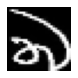

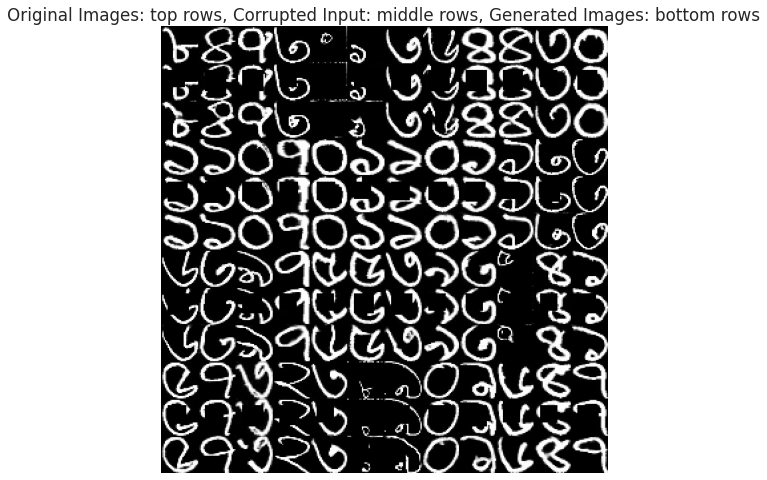

  1%|          | 2/191 [00:00<00:16, 11.49it/s]

Epoch 54


100%|██████████| 191/191 [00:12<00:00, 14.90it/s]


Discriminator Loss:  0.618008017539978 , Adversarial Loss:  1.0116106271743774
NOISED


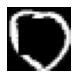

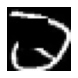

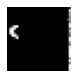

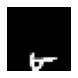

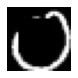

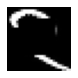

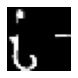

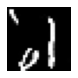

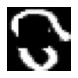

GENERATED


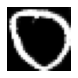

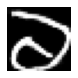

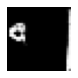

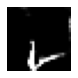

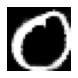

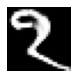

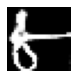

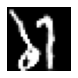

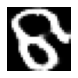

ORIGINAL


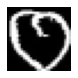

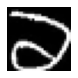

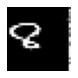

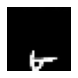

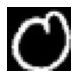

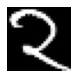

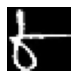

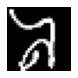

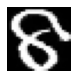

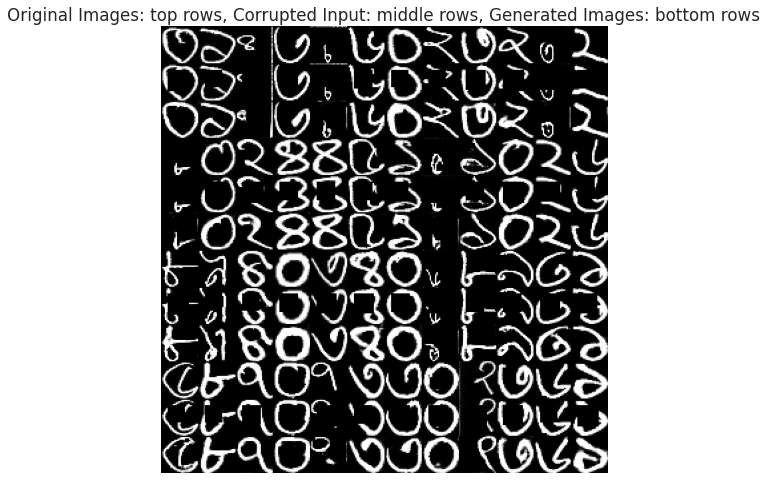

  1%|          | 2/191 [00:00<00:16, 11.58it/s]

Epoch 55


100%|██████████| 191/191 [00:12<00:00, 15.32it/s]


Discriminator Loss:  0.5987470149993896 , Adversarial Loss:  1.058655858039856
NOISED


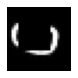

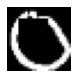

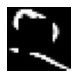

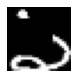

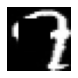

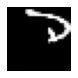

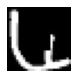

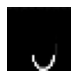

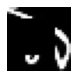

GENERATED


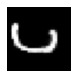

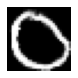

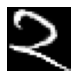

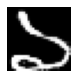

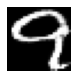

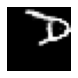

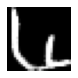

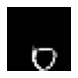

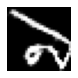

ORIGINAL


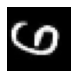

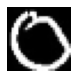

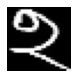

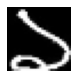

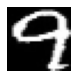

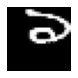

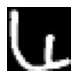

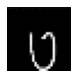

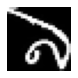

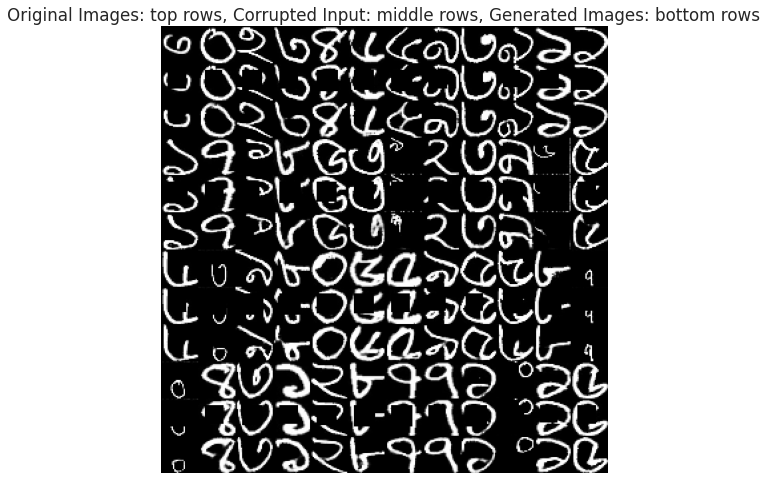

  1%|          | 2/191 [00:00<00:15, 12.23it/s]

Epoch 56


100%|██████████| 191/191 [00:12<00:00, 14.81it/s]


Discriminator Loss:  0.5939109325408936 , Adversarial Loss:  0.8600012063980103
NOISED


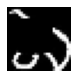

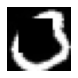

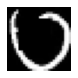

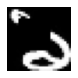

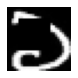

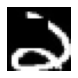

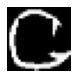

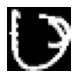

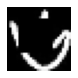

GENERATED


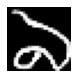

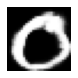

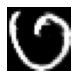

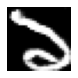

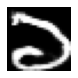

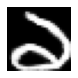

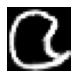

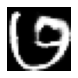

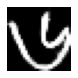

ORIGINAL


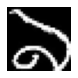

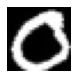

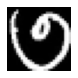

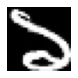

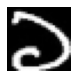

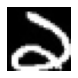

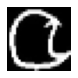

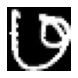

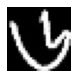

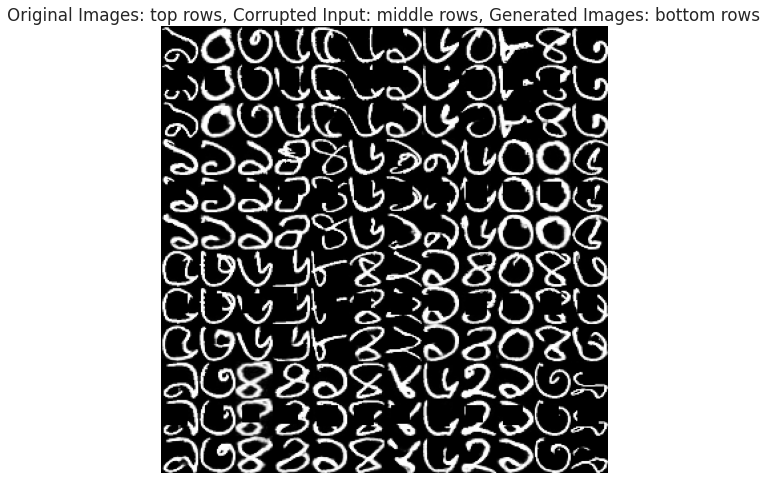

  1%|          | 2/191 [00:00<00:15, 11.86it/s]

Epoch 57


100%|██████████| 191/191 [00:12<00:00, 15.40it/s]


Discriminator Loss:  0.5751712322235107 , Adversarial Loss:  0.9996353387832642
NOISED


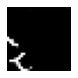

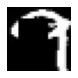

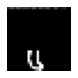

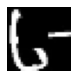

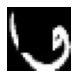

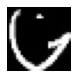

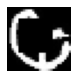

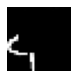

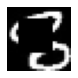

GENERATED


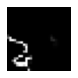

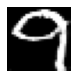

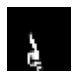

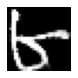

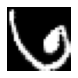

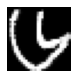

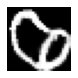

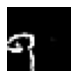

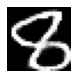

ORIGINAL


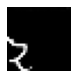

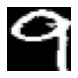

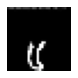

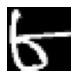

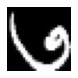

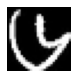

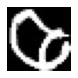

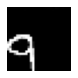

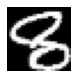

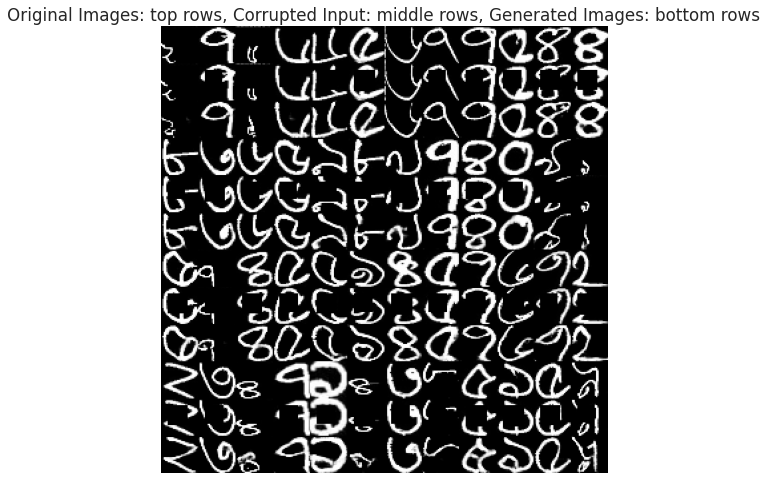

  1%|          | 2/191 [00:00<00:16, 11.54it/s]

Epoch 58


100%|██████████| 191/191 [00:12<00:00, 14.94it/s]


Discriminator Loss:  0.5688360333442688 , Adversarial Loss:  0.772517204284668
NOISED


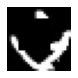

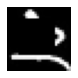

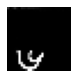

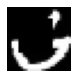

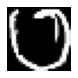

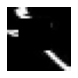

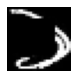

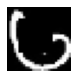

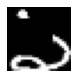

GENERATED


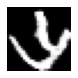

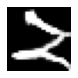

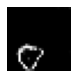

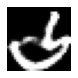

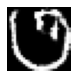

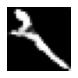

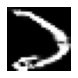

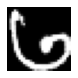

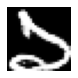

ORIGINAL


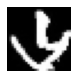

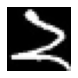

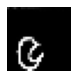

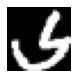

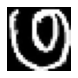

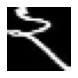

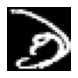

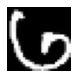

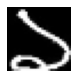

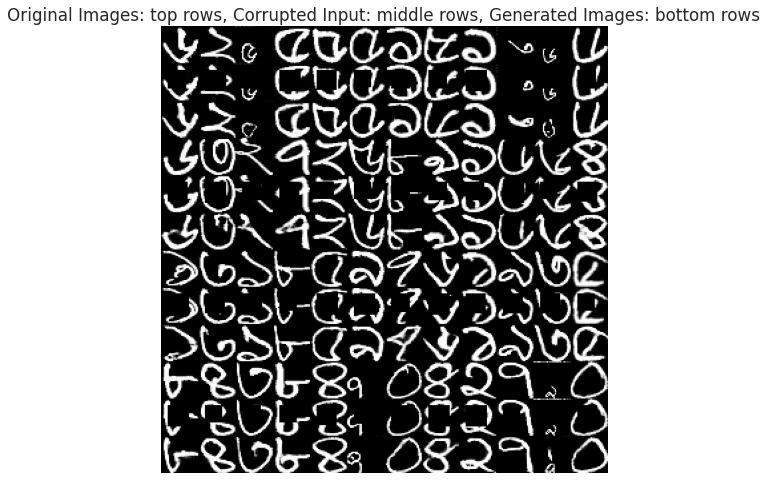

  1%|          | 2/191 [00:00<00:17, 11.00it/s]

Epoch 59


100%|██████████| 191/191 [00:12<00:00, 15.19it/s]


Discriminator Loss:  0.6995493769645691 , Adversarial Loss:  0.9430895447731018
NOISED


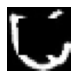

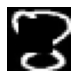

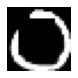

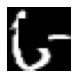

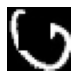

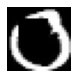

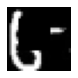

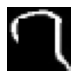

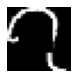

GENERATED


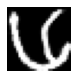

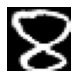

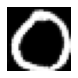

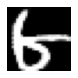

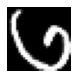

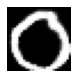

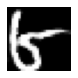

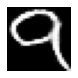

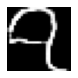

ORIGINAL


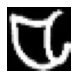

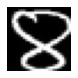

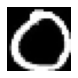

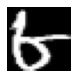

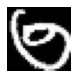

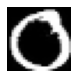

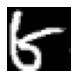

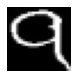

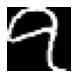

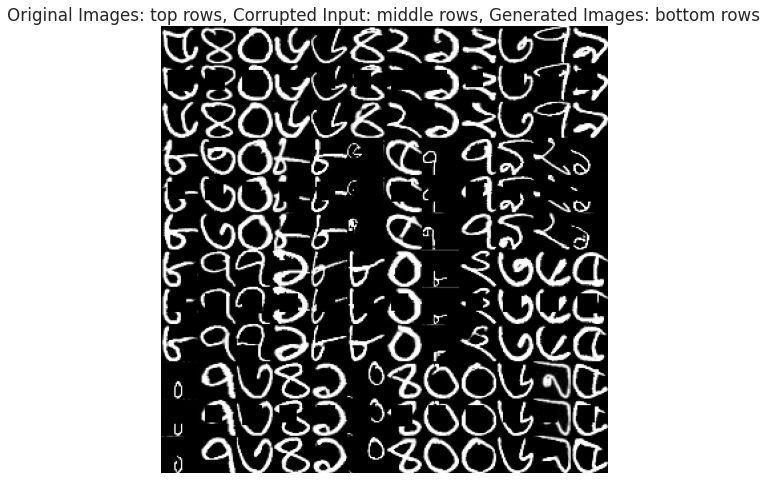

  1%|          | 2/191 [00:00<00:17, 11.09it/s]

Epoch 60


100%|██████████| 191/191 [00:12<00:00, 15.55it/s]


Discriminator Loss:  0.5934869647026062 , Adversarial Loss:  1.0711309909820557
NOISED


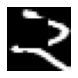

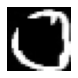

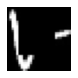

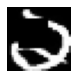

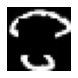

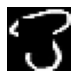

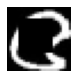

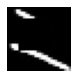

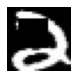

GENERATED


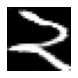

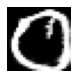

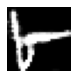

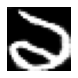

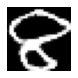

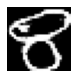

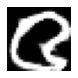

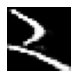

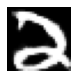

ORIGINAL


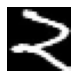

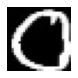

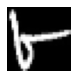

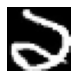

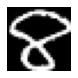

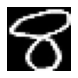

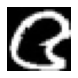

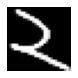

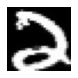

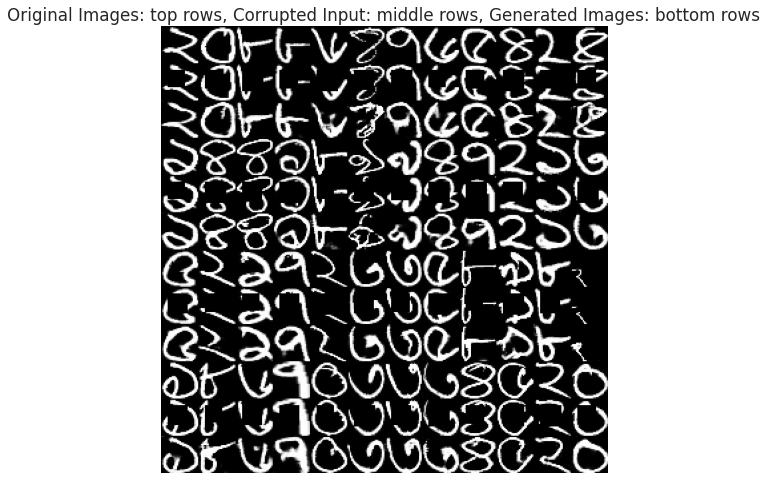

  1%|          | 2/191 [00:00<00:15, 12.13it/s]

Epoch 61


100%|██████████| 191/191 [00:12<00:00, 15.59it/s]


Discriminator Loss:  0.6255438327789307 , Adversarial Loss:  1.0663750171661377
NOISED


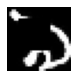

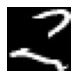

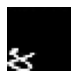

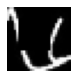

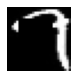

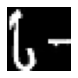

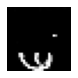

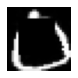

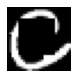

GENERATED


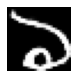

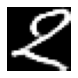

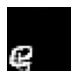

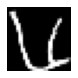

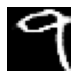

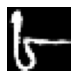

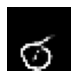

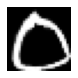

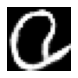

ORIGINAL


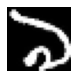

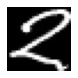

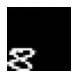

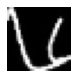

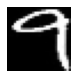

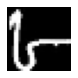

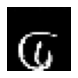

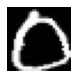

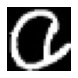

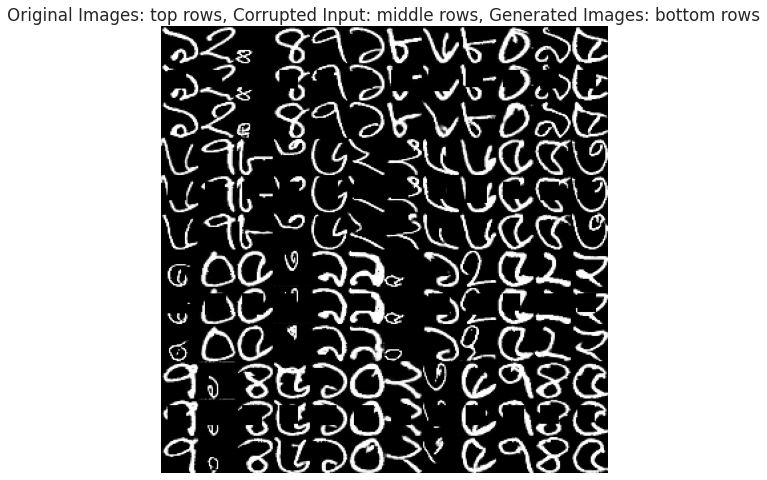

  1%|          | 1/191 [00:00<00:20,  9.37it/s]

Epoch 62


100%|██████████| 191/191 [00:12<00:00, 15.33it/s]


Discriminator Loss:  0.5781758427619934 , Adversarial Loss:  1.1232436895370483
NOISED


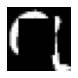

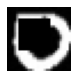

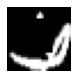

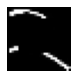

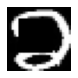

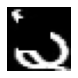

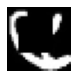

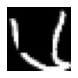

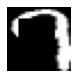

GENERATED


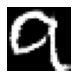

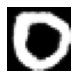

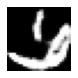

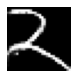

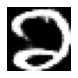

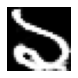

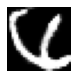

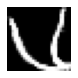

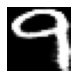

ORIGINAL


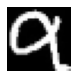

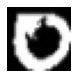

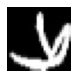

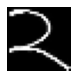

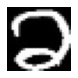

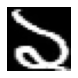

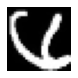

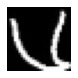

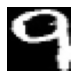

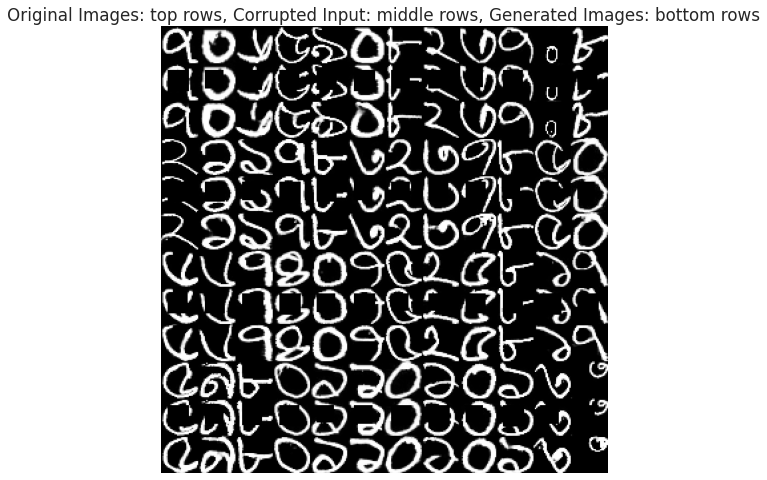

  1%|          | 2/191 [00:00<00:16, 11.33it/s]

Epoch 63


100%|██████████| 191/191 [00:12<00:00, 15.36it/s]


Discriminator Loss:  0.4816288948059082 , Adversarial Loss:  0.44498446583747864
NOISED


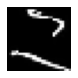

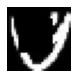

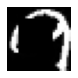

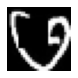

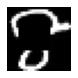

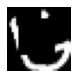

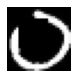

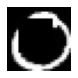

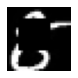

GENERATED


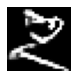

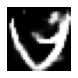

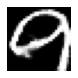

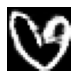

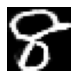

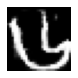

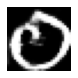

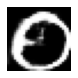

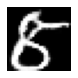

ORIGINAL


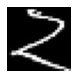

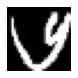

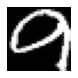

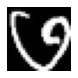

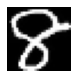

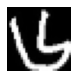

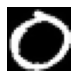

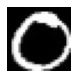

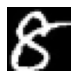

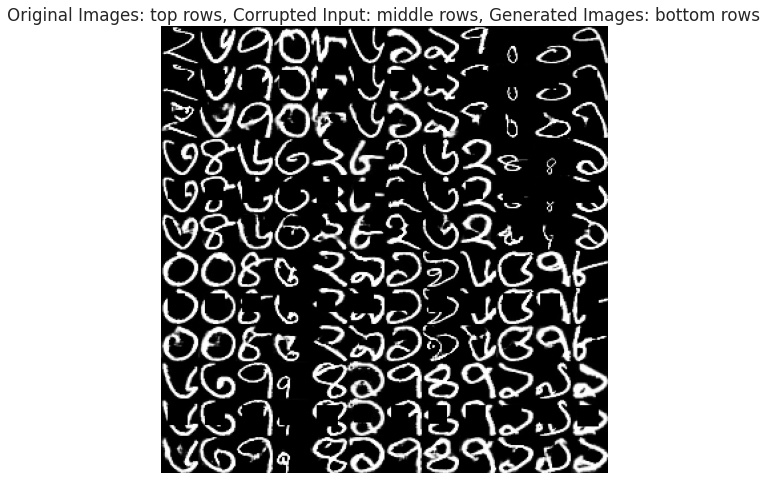

  1%|          | 1/191 [00:00<00:19,  9.74it/s]

Epoch 64


100%|██████████| 191/191 [00:12<00:00, 15.41it/s]


Discriminator Loss:  0.6041195392608643 , Adversarial Loss:  1.049058198928833
NOISED


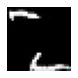

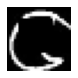

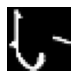

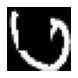

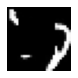

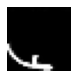

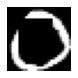

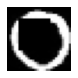

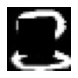

GENERATED


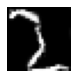

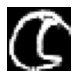

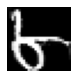

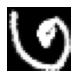

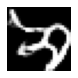

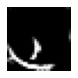

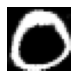

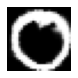

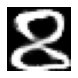

ORIGINAL


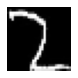

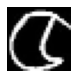

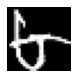

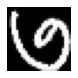

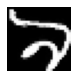

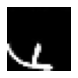

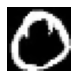

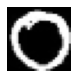

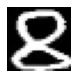

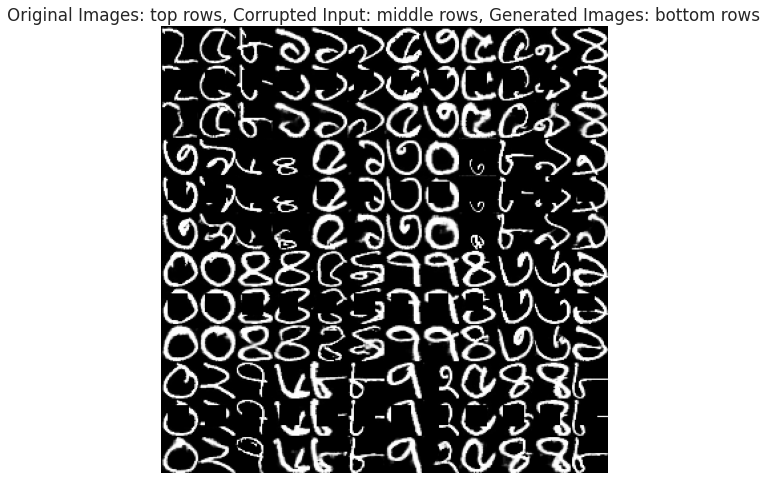

  1%|          | 2/191 [00:00<00:15, 12.02it/s]

Epoch 65


100%|██████████| 191/191 [00:12<00:00, 15.06it/s]


Discriminator Loss:  0.6079136729240417 , Adversarial Loss:  1.0210564136505127
NOISED


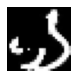

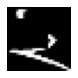

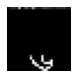

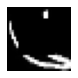

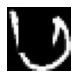

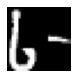

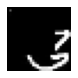

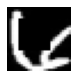

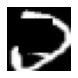

GENERATED


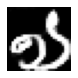

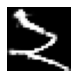

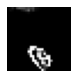

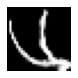

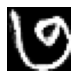

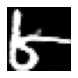

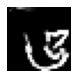

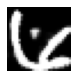

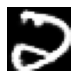

ORIGINAL


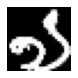

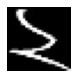

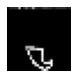

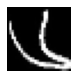

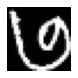

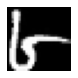

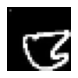

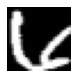

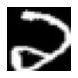

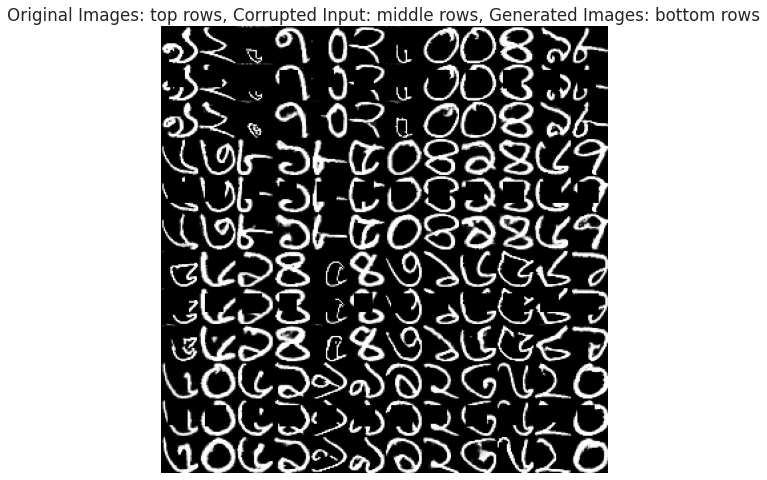

  1%|          | 2/191 [00:00<00:16, 11.36it/s]

Epoch 66


100%|██████████| 191/191 [00:12<00:00, 15.43it/s]


Discriminator Loss:  0.6166704893112183 , Adversarial Loss:  1.1464793682098389
NOISED


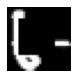

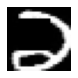

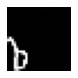

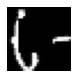

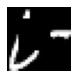

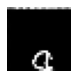

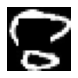

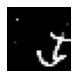

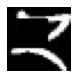

GENERATED


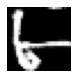

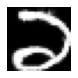

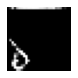

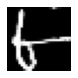

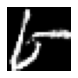

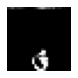

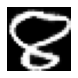

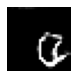

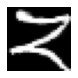

ORIGINAL


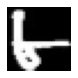

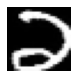

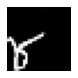

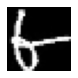

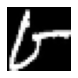

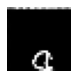

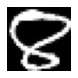

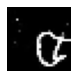

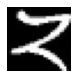

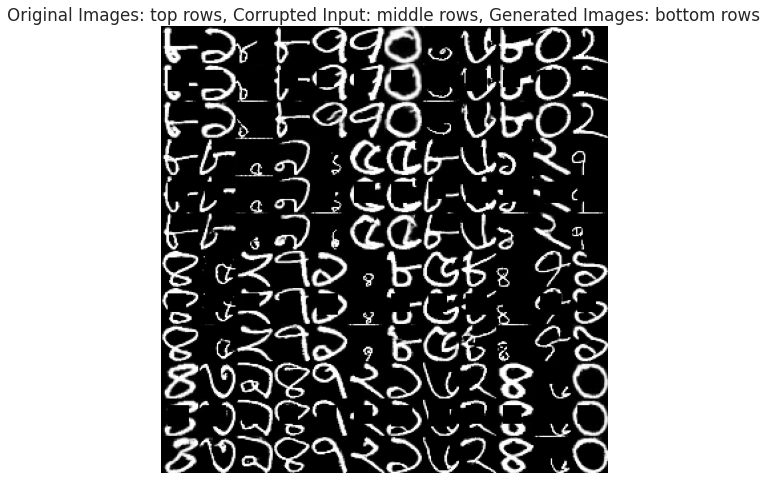

  1%|          | 2/191 [00:00<00:15, 12.37it/s]

Epoch 67


100%|██████████| 191/191 [00:12<00:00, 14.76it/s]


Discriminator Loss:  0.5076310634613037 , Adversarial Loss:  0.8455754518508911
NOISED


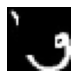

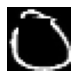

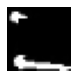

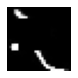

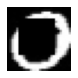

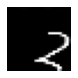

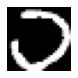

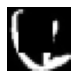

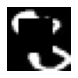

GENERATED


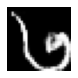

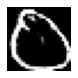

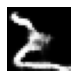

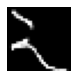

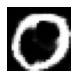

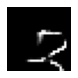

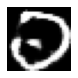

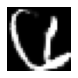

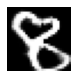

ORIGINAL


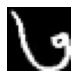

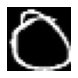

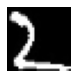

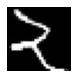

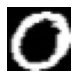

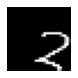

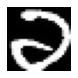

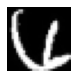

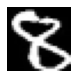

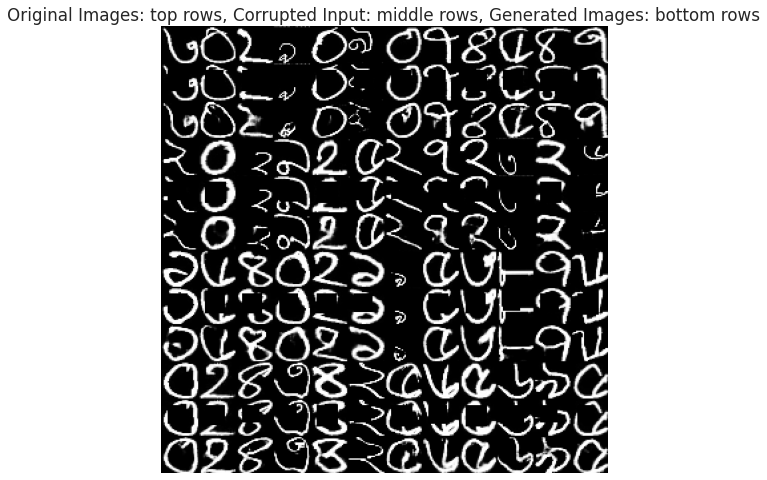

  1%|          | 2/191 [00:00<00:15, 12.23it/s]

Epoch 68


100%|██████████| 191/191 [00:13<00:00, 14.65it/s]

Discriminator Loss:  0.6005160808563232 , Adversarial Loss:  0.5907489657402039
NOISED


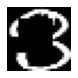

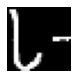

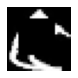

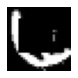

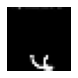

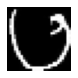

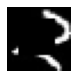

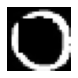

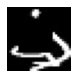

GENERATED


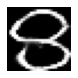

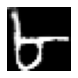

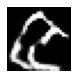

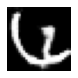

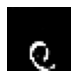

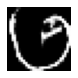

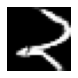

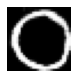

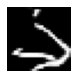

ORIGINAL


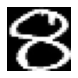

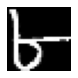

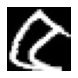

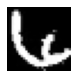

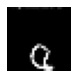

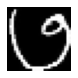

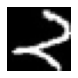

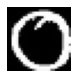

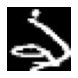

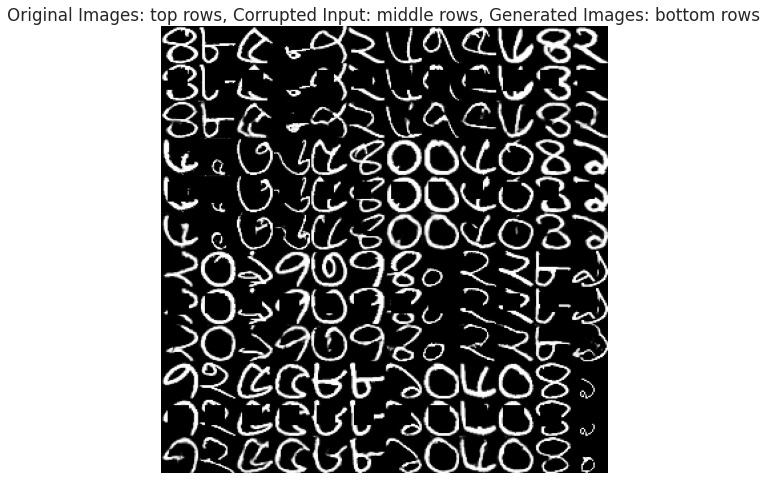

  1%|          | 2/191 [00:00<00:15, 12.11it/s]

Epoch 69


100%|██████████| 191/191 [00:12<00:00, 14.90it/s]

Discriminator Loss:  0.5744491815567017 , Adversarial Loss:  0.8639122247695923
NOISED


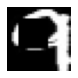

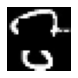

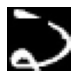

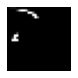

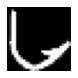

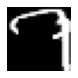

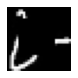

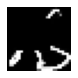

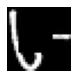

GENERATED


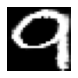

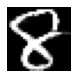

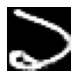

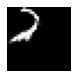

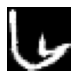

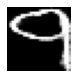

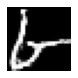

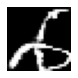

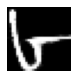

ORIGINAL


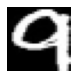

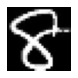

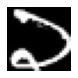

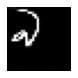

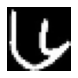

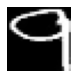

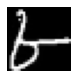

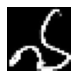

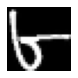

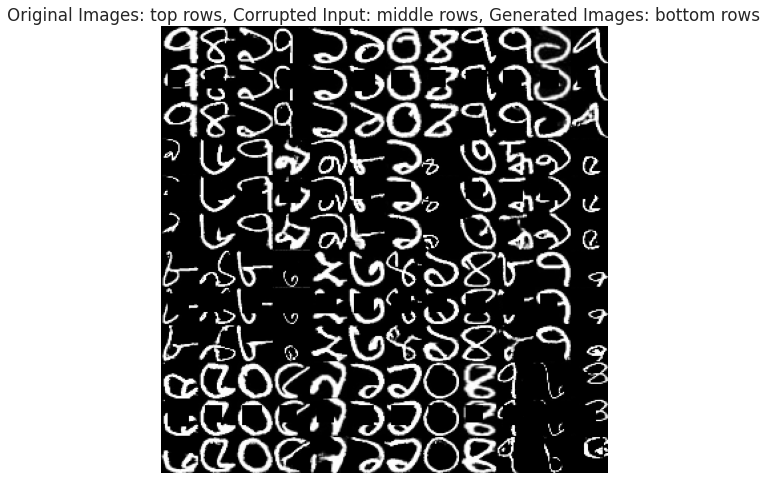

  1%|          | 2/191 [00:00<00:15, 11.85it/s]

Epoch 70


100%|██████████| 191/191 [00:13<00:00, 14.20it/s]

Discriminator Loss:  0.6038596630096436 , Adversarial Loss:  1.014693260192871
NOISED


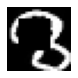

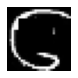

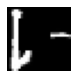

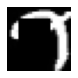

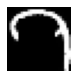

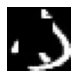

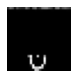

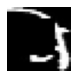

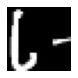

GENERATED


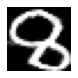

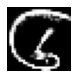

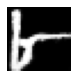

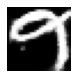

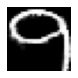

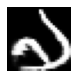

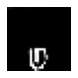

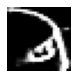

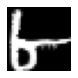

ORIGINAL


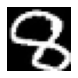

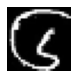

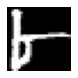

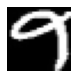

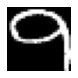

...

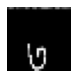

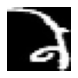

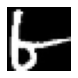

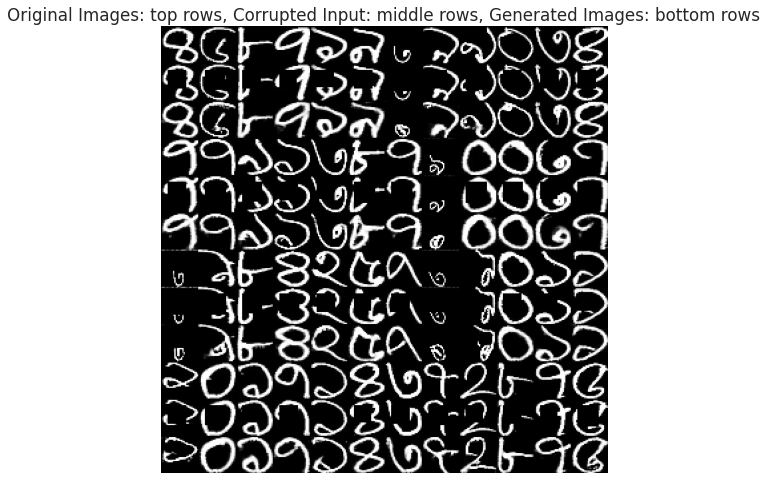

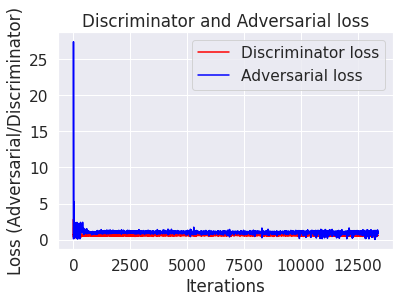

In [ ]:
def train(X_train,      noised_train_data,
          input_shape,  smooth_real,
          epochs,       batch_size,
          optimizer_g, optimizer_d):
    """Training GAN."""
    discriminator_losses = []
    generator_losses = []

    # Number of iteration possible with batches of size 128
    iterations = X_train.shape[0] // batch_size
    # Load the generator and the discriminator
    generator = img_generator(input_shape)
    discriminator = img_discriminator(input_shape)
    # Compile the discriminator with binary_crossentropy loss
    discriminator.compile(loss='binary_crossentropy', optimizer=optimizer_d)
    # Feed the generator and the discriminator to the function dcgan
    # to form the DCGAN architecture
    gan = dcgan(discriminator, generator, input_shape)
    # Compile the DCGAN with binary_crossentropy loss
    gan.compile(loss='binary_crossentropy', optimizer=optimizer_g)

    for i in range(epochs):
        print('Epoch %d' % (i+1))
        # Use tqdm to get an estimate of time remaining
        for j in tqdm(range(1, iterations+1)):
            # batch of original images (batch = batchsize)
            original = X_train[np.random.randint(0, X_train.shape[0],
                                                 size=batch_size)]
            # batch of noised images (batch = batchsize)
            noise = noised_train_data[np.random.randint(0,
                                                        noised_train_data.shape[0],
                                                        size=batch_size)]
            # Generate fake images
            generated_images = generator.predict(noise)
            # Labels for generated data
            dis_lab = np.zeros(2*batch_size)
            dis_train = np.concatenate([original, generated_images])
            # label smoothing for original images
            dis_lab[:batch_size] = smooth_real
            # Train discriminator on original iamges
            discriminator.trainable = True
            discriminator_loss = discriminator.train_on_batch(dis_train,
                                                              dis_lab)
            # save the losses
            discriminator_losses.append(discriminator_loss)
            # Train generator
            gen_lab = np.ones(batch_size)
            discriminator.trainable = False
            sample_indices = np.random.randint(0, X_train.shape[0],
                                               size=batch_size)
            original = X_train[sample_indices]
            noise = noised_train_data[sample_indices]

            generator_loss = gan.train_on_batch(noise, gen_lab)
            # save the losses
            generator_losses.append(generator_loss)
            if i == 0 and j == 1:
                print('Iteration - %d', j)
                generated_images_plot(original, noise, generator)
                plot_generated_images_combined(original, noise, generator)

        print("Discriminator Loss: ", discriminator_loss,
              ", Adversarial Loss: ", generator_loss)
        generated_images_plot(original, noise, generator)
        plot_generated_images_combined(original, noise, generator)
    # plot the losses
    plot_training_loss(discriminator_losses, generator_losses)

    return generator


generator = train(X_train, noised_train_data,
                  input_shape, smooth_real,
                70, batch_size,
                  optimizer_g, optimizer_d)


In [ ]:
# restore missing parts of the digit with the generator
gen_imgs_test = generator.predict(noised_test_data)

In [ ]:
mnist_model.evaluate(gen_imgs_test,y_test)

192/192 [==============================] - 0s 2ms/step - loss: 0.4273 - accuracy: 0.8936


[0.42729896306991577, 0.8936135768890381]

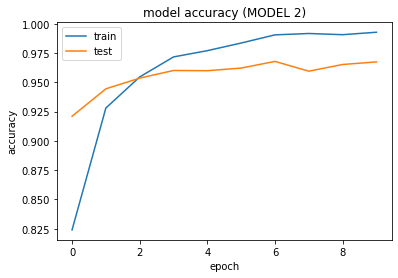

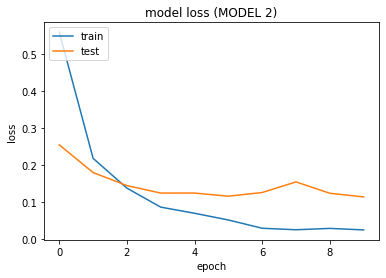

In [ ]:
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy (MODEL 2)')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('model loss (MODEL 2)')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

In [ ]:
li = []

li.append(img)
li.append(image)

In [ ]:
nd = np.array(li)

In [ ]:
nd.shape

In [ ]:
cd '/content'

In [ ]:
!unzip '/content/110.zip' 

In [ ]:
imgl = glob.glob('110/*')

In [ ]:
array = np.array(image)
i = random.choice(range(8,12)) # x coordinate for the top left corner of the mask
j = random.choice(range(8,12)) # y coordinate for the top left corner of the mask
array[0:i+8, 0:j+8]=-1.0

In [ ]:
array[i:i+8, j:j+8] = 5

In [ ]:
array[i:i+8, j:j+8]

In [ ]:
plt.imshow(array)

In [ ]:
#confusion matrix
from sklearn.metrics import confusion_matrix


y_pred =mnist_model.predict_classes(gen_imgs_test)
y_pred2 = mnist_model.predict_classes(noised_test_data)
y_pred3 = mnist_model.predict_classes(X_test)

/usr/local/lib/python3.6/dist-packages/tensorflow/python/keras/engine/sequential.py:450: UserWarning: `model.predict_classes()` is deprecated and will be removed after 2021-01-01. Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
  warnings.warn('`model.predict_classes()` is deprecated and '


In [ ]:
y_pred = y_pred.tolist()
y_pred2 = y_pred2.tolist()
y_pred3 = y_pred3.tolist()

In [ ]:
y_te = y_te.tolist()

NameError: ignored

In [ ]:
def plot_cm(y_true, y_pred,tit, figsize=(20,20)):
    cm = confusion_matrix(y_true, y_pred, labels=np.unique(y_true))
    cm_sum = np.sum(cm, axis=1, keepdims=True)
    cm_perc = cm / cm_sum.astype(float) * 100
    annot = np.empty_like(cm).astype(str)
    nrows, ncols = cm.shape
    for i in range(nrows):
        for j in range(ncols):
            c = cm[i, j]
            p = cm_perc[i, j]
            if i == j:
                s = cm_sum[i]
                annot[i, j] = '%.1f%%\n%d/%d' % (p, c, s)
            elif c == 0:
                annot[i, j] = ''
            else:
                annot[i, j] = '%.1f%%\n%d' % (p, c)
    cm = pd.DataFrame(cm, index=np.unique(y_true), columns=np.unique(y_true))
    cm.index.name = 'Actual'
    cm.columns.name = 'Predicted'
    fig, ax = plt.subplots(figsize=figsize)
    sns.heatmap(cm, cmap= "YlGnBu", annot=annot, fmt='', ax=ax)
    plt.title(tit)
    plt.show()

In [ ]:
plot_cm(y_te, y_pred, "GAN")


NameError: ignored

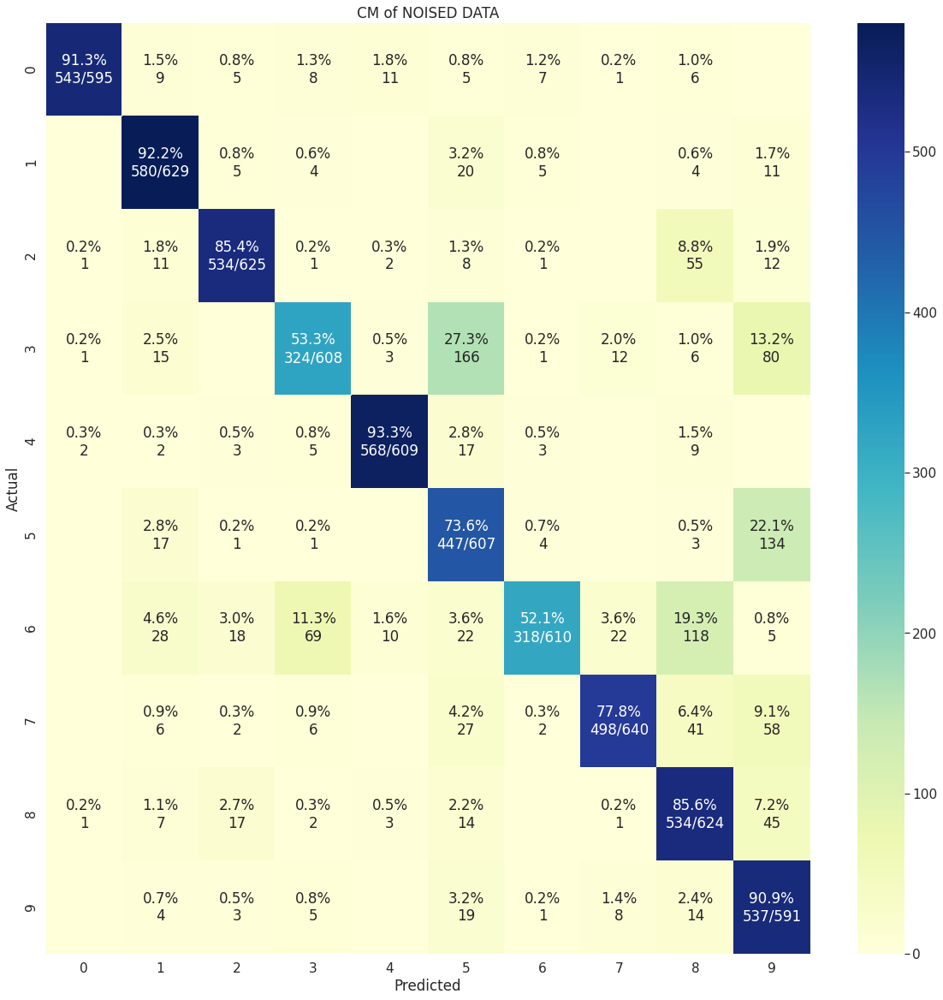

In [ ]:
plot_cm(y_te, y_pred2, "CM of NOISED DATA")

In [ ]:
plot_cm(y_te, y_pred3, "CM of Orginal Data")

NameError: ignored

In [ ]:
sample_indices = np.random.randint(0, 30000,size=128)

In [ ]:
sample_indices

array([10976, 12458, 21906,  9608, 29929, 20815, 12936, 18084, 17640,
       25828,  3063, 17334, 17632, 18472,  3678, 10069, 23284, 19295,
       16623, 15479,  9357,  8539, 13019, 14345, 21684,  6568, 10745,
       16313, 26125,  5969,  6276, 25290, 21305, 10957,  8858,  6843,
         532, 26056, 27740,   642,  5287, 19036, 23097, 26988,  7363,
       18863, 10788,  5522,  7486, 29425,  3954, 26799, 23023, 19921,
        8682,   375, 27991, 20523, 29538,  9924, 19790, 15570, 10433,
       29524, 10492, 15043, 10243, 28129, 24240, 29424, 18164, 24655,
        4377,  5251,  4136, 12198, 20937,  1332, 19866,  8702,  9554,
        9515, 15791, 19675,  7067, 15610, 25103,  3886,  2018, 17862,
       25182, 24472, 24687,  3859,  6516, 22282,  3111,  5066, 15865,
       23701,  1250, 12952, 13712, 11129, 20221,  3510, 22004,   542,
       29903, 25492, 20006, 16965,  3137,  9200, 17042, 24902, 12636,
        2645,  1506, 17919,   672,  4820,  4433,   901, 21367,  8852,
       12423, 23177]

In [ ]:
dis_lab = np.zeros(2*128)

In [ ]:
len(dis_lab)

256

In [ ]:
iterations = 31000 // 128

In [ ]:
211*128

27008